# 2022. 03. 23.

In [1]:
from mcbj import *
from tqdm.notebook import tqdm
import filter_traces
import plots
import pandas as pd

date = "22_03_23"
sample_rate = 50_000
home_folder = Path(f"D:/BJ_Data/{date}")
import numpy as np
from matplotlib.ticker import MultipleLocator

# import warnings
# warnings.filterwarnings('ignore')

In [6]:
import scipy.signal

In [9]:
trace_pair = TracePair(2, load_from=home_folder)

<AxesSubplot:xlabel='Piezo [V]', ylabel='Conductance [$G_{0}$]'>

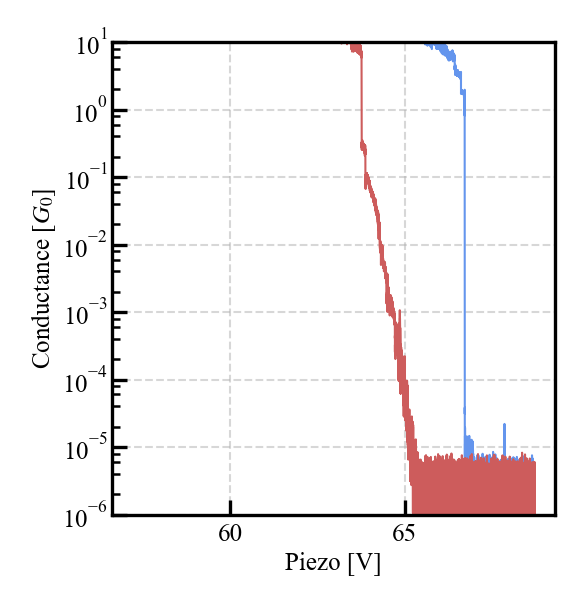

In [11]:
trace_pair.plot_trace_pair(dpi=300)

In [ ]:
scipy.signal.stft(x, fs=1.0, window='hann', nperseg=256, noverlap=None, nfft=None, detrend=False,
                                         return_onesided=True, boundary='zeros', padded=True, axis=- 1)

# Summary

## Clean measurements

Measurement to test the new gold wire from Sigma Aldrich (diameter: 0.1 mm, 99.99% trace metals, opened: 2022. 03. 18.)

Clean measurements look nice, no sign of contamination.

## Molecular measurements

At trace 36001, 15 s evaporation of the new BPY (opened: 2022.03.25.)

After the evaporation, clear sign of BPY, at first the two peaks did not separate, but later nice 2 peak histogram observed.
Unfortunately not so long after evaporation more and more clean traces, so more attention and more frequent evaporation seems necessary.

# Technical info

## Details:

Room temperature measurement with ambient pressure using the MCBJ (UFO) setup and mechanically fixed sample holder.

Mechanically fixed sample holder cleaned: (AC + IPA + dest. water) $\times 2$, then dried and 15 min UV O3.
Blade used to cut sample cleaned with flowing (AC + IPA + dest. water) $\times 2$, then dried

**IV**: Femto 1e7

## Calibration:

|                     |                     |
|:-------------------:|:-------------------:|
| $V_{\text{offset}}$ | $0.001\;\mathrm{V}$ |
| $R_{\text{serial}}$ | $99900\;\Omega$     |
| $I_{\text{offset}}$ | $76.9129\;\text{pA}$|


# Statistics for the first 20200 traces

**BJ Settings:**

|                   |           |
|-------------------|:-----------:|
| rate              |  $8$        |
| pull excursion    | $2$         |
| push excursion    | $2$         |
| $G_{\text{low}}$  | $10^{-5}$ |
| $G_{\text{high}}$ | $10$      |

**1D histograms**: 100 bins per decade

**2D histograms**: 250 bins along horizontal and 400 bins along vertical axis, aligned at $10^{-5}\;G_0$ first and then also at $0.5\;G_0$

In [2]:
hist_1 = Histogram(home_folder, 1, 20200)

hist_1.calc_stats(align_at=1e-5, range_pull=(-0.6, 0.55), range_push=(-2, 1), xbins_pull=250, xbins_push=400,
                  plateau_length_bins=100)

Processing break junction files:   0%|          | 0/203 [00:00<?, ?it/s]

Pull 2D histogram created from 20136 traces
Push 2D histogram created from 20132 traces


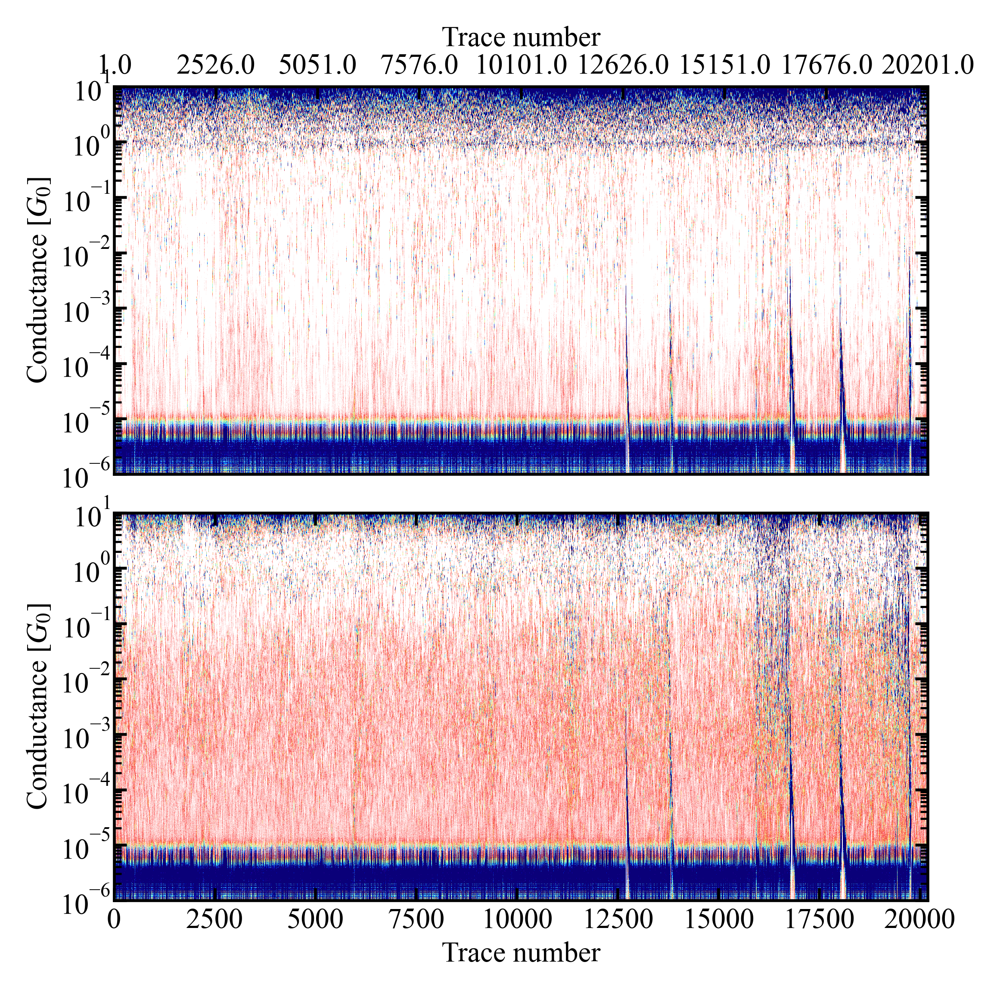

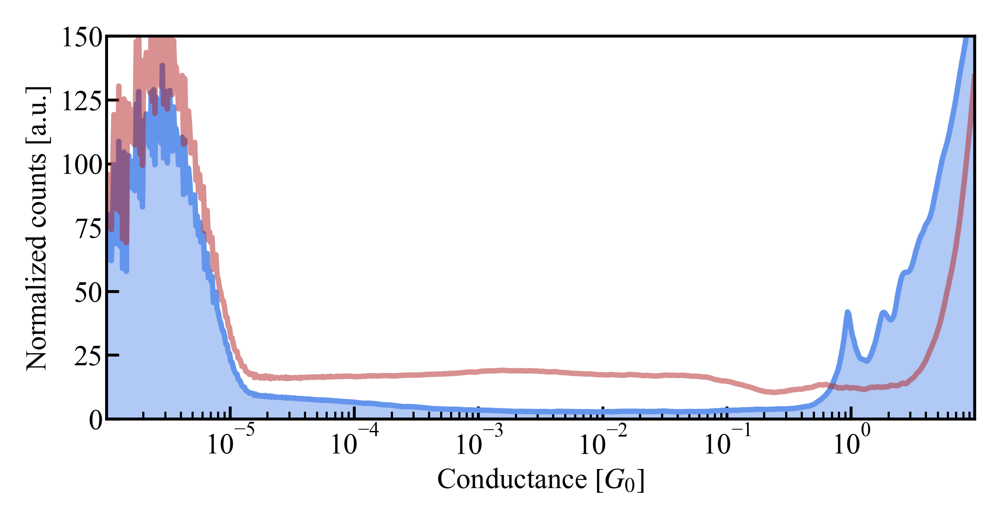

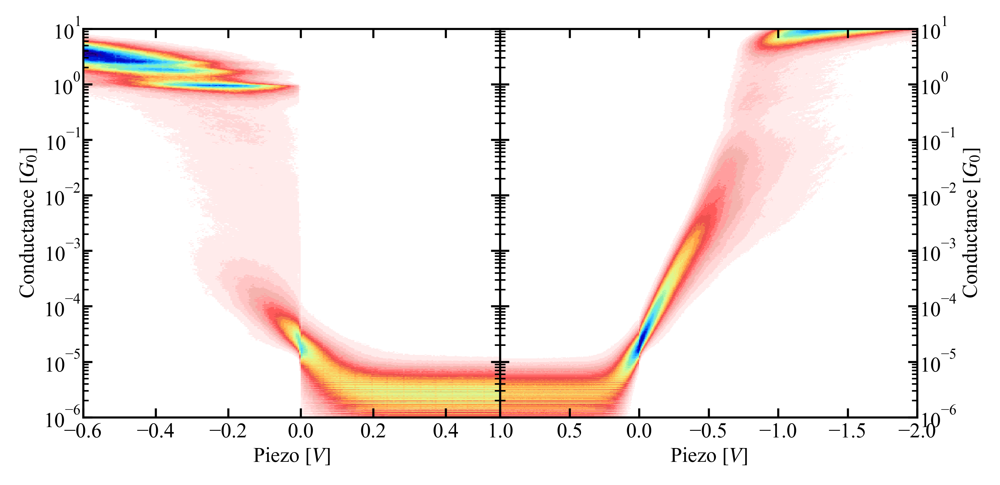

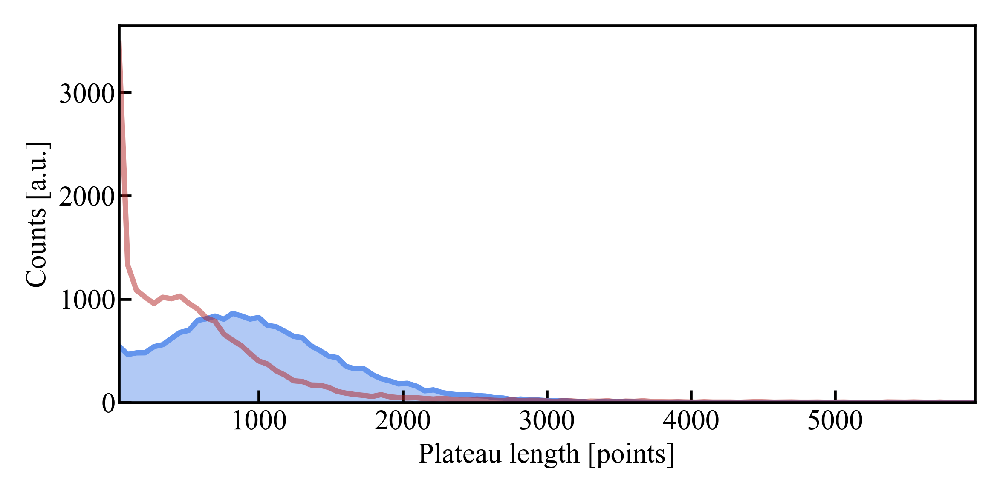

In [3]:
ax_temp_pull, ax_temp_push = hist_1.plot_temporal_hist(vmax=100)
ax_temp_pull.set_xticks(np.linspace(start=0, stop=hist_1.temporal_hist_pull.shape[0], num=9, endpoint=True))
ax_temp_pull.set_xticklabels(np.linspace(start=1, stop=hist_1.temporal_hist_pull.shape[0]+1, num=9, endpoint=True))
ax_1d = hist_1.plot_hist_1d(ylims=(0, 150))
ax_pull, ax_push = hist_1.plot_hist_2d_both()
ax_plat = hist_1.plot_plateau_length_hist()

In [4]:
hist_1.calc_hist_2d(align_at=0.5, range_pull=(-0.5, 0.55), range_push=(-0.5, 1.5),
                    xbins_pull=200, xbins_push=250)

Calculating 2D conductance-displacement histograms:   0%|          | 0/203 [00:00<?, ?it/s]

2D histogram pull direction created from 20196 traces
2D histogram push direction created from 20200 traces


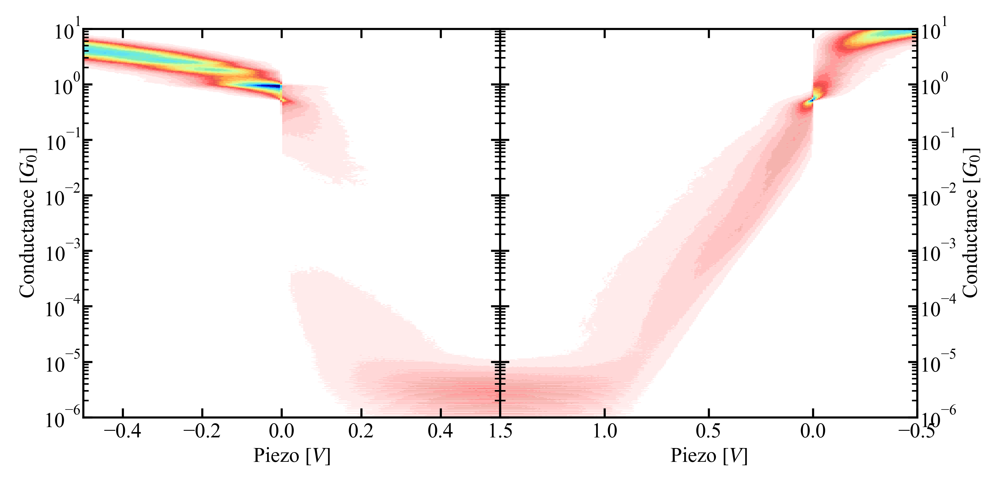

In [5]:
ax_pull, ax_push = hist_1.plot_hist_2d_both()

# Statistics for traces 20201-21200

**BJ Settings:**

|                   |           |
|-------------------|:-----------:|
| rate              |  $4$        |
| pull excursion    | $2$         |
| push excursion    | $2$         |
| $G_{\text{low}}$  | $10^{-5}$ |
| $G_{\text{high}}$ | $10$      |

On the temporal histogram at tracenumber $\sim 21100$ issue is because of traces with very long tunnel like ending, but training the contact solved this issue.

In [6]:
hist_2 = Histogram(home_folder, 20201, 21200)

hist_2.calc_stats(align_at=1e-5, range_pull=(-0.8, 0.55), range_push=(-3, 1), xbins_pull=250, xbins_push=400,
                  plateau_length_bins=100)

Processing break junction files:   0%|          | 0/11 [00:00<?, ?it/s]

Pull 2D histogram created from 986 traces
Push 2D histogram created from 983 traces


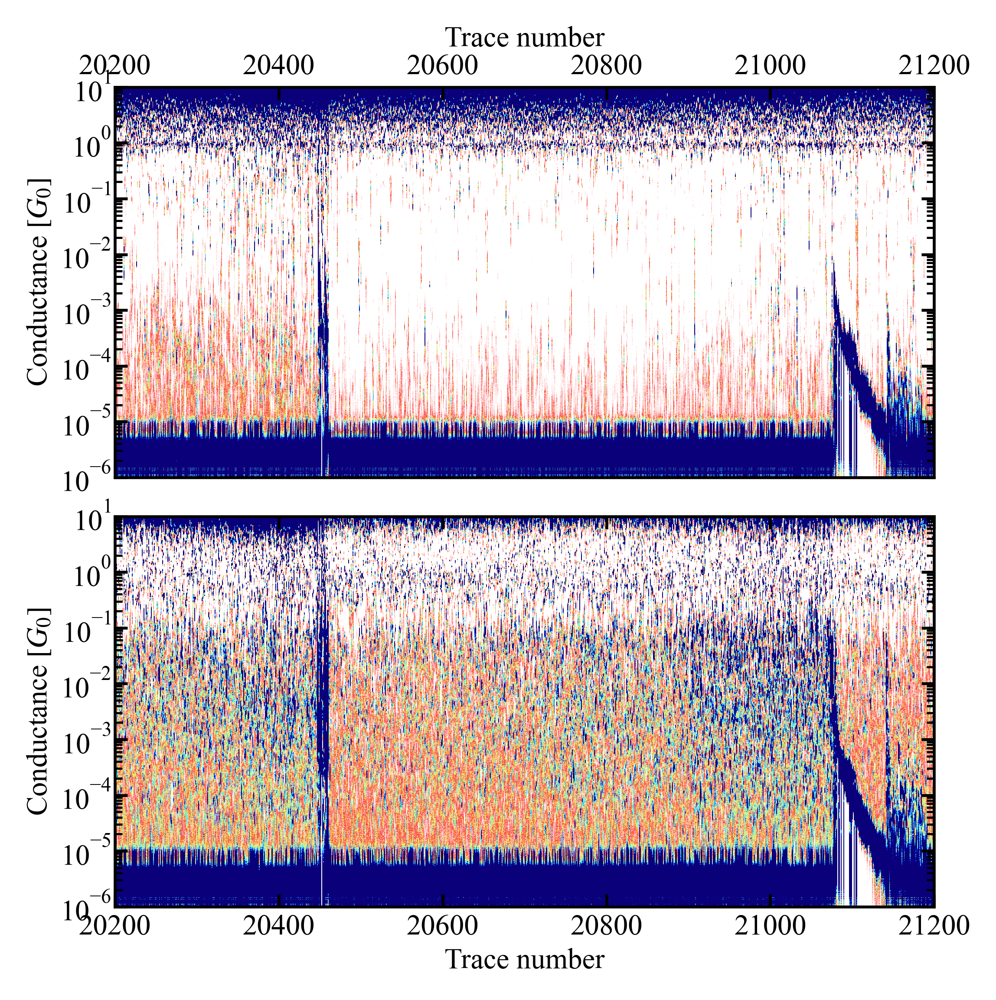

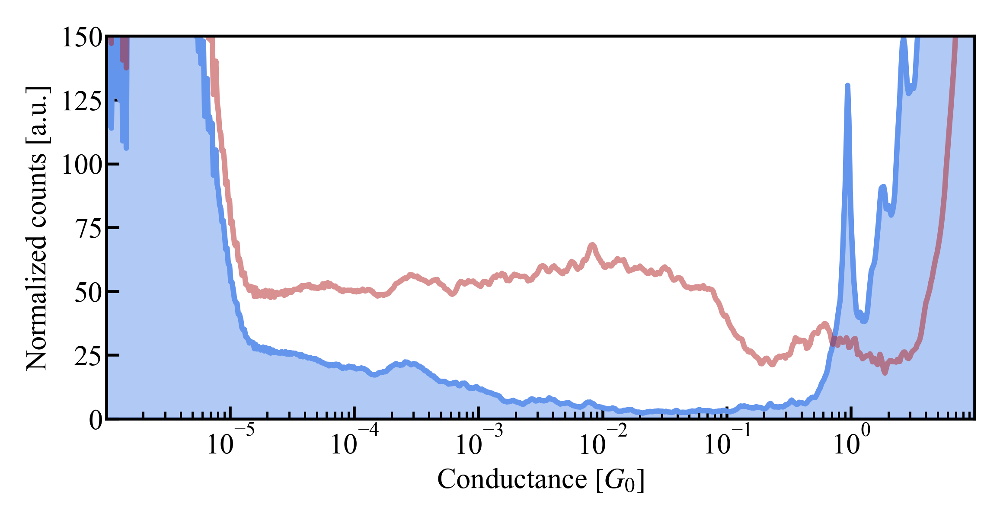

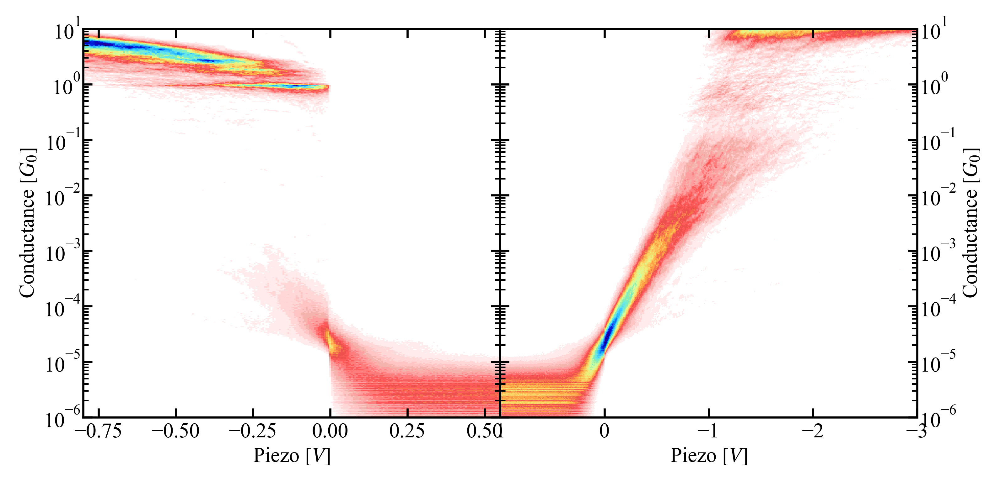

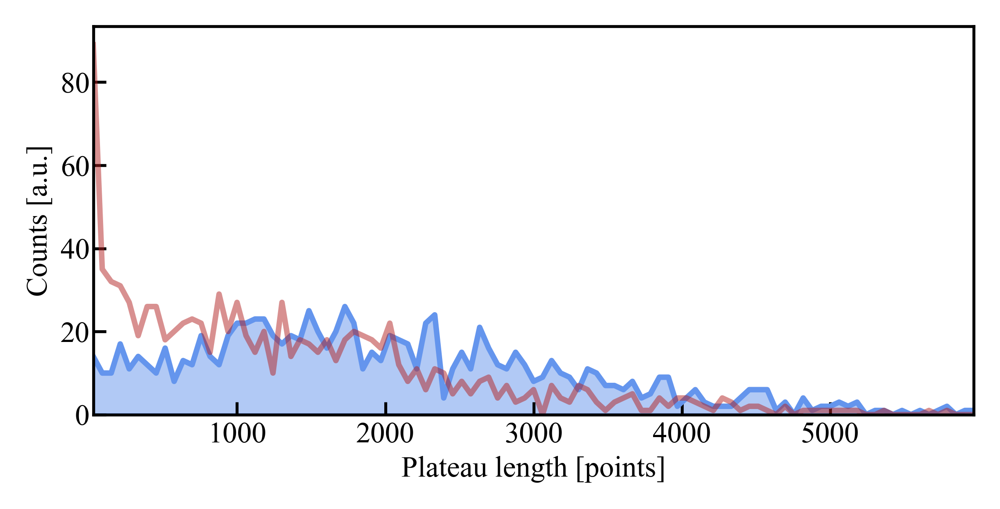

In [7]:
ax_temp_pull, ax_temp_push = hist_2.plot_temporal_hist(vmax=100)
ax_temp_pull.set_xticks(np.linspace(0, 1000, 6).astype(int))
ax_temp_pull.set_xticklabels(np.linspace(20200, 21200, 6).astype(int))
ax_temp_push.set_xticks(np.linspace(0, 1000, 6).astype(int))
ax_temp_push.set_xticklabels(np.linspace(20200, 21200, 6).astype(int))
ax_1d = hist_2.plot_hist_1d(ylims=(0, 150))
ax_pull, ax_push = hist_2.plot_hist_2d_both()
ax_plat = hist_2.plot_plateau_length_hist()

In [8]:
hist_2.calc_hist_2d(align_at=0.5, range_pull=(-0.5, 0.55), range_push=(-0.5, 1.7),
                    xbins_pull=200, xbins_push=250)

Calculating 2D conductance-displacement histograms:   0%|          | 0/11 [00:00<?, ?it/s]

2D histogram pull direction created from 1000 traces
2D histogram push direction created from 1000 traces


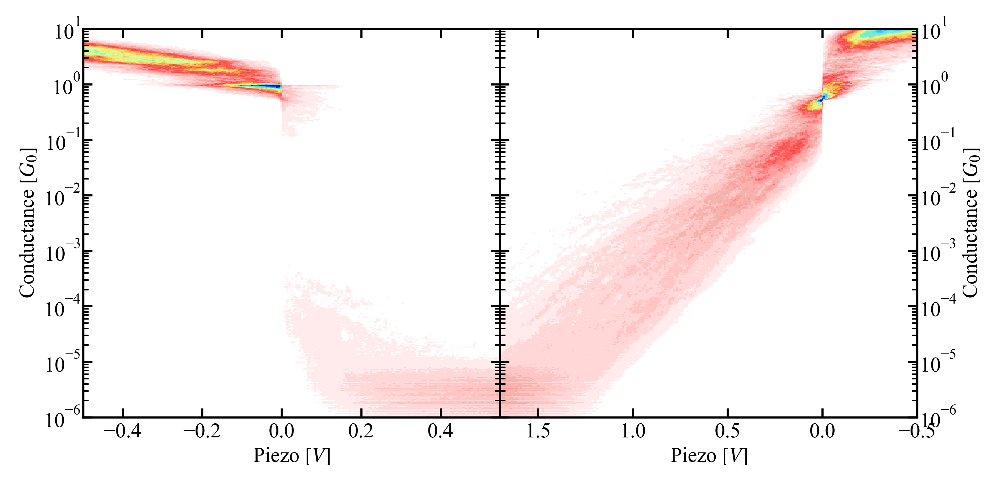

In [9]:
ax_pull, ax_push = hist_2.plot_hist_2d_both()

# Statistics for traces 21201-25200

**BJ Settings:**

|                   |           |
|-------------------|:-----------:|
| rate              |  $2$        |
| pull excursion    | $2$         |
| push excursion    | $2$         |
| $G_{\text{low}}$  | $10^{-5}$ |
| $G_{\text{high}}$ | $10$      |

In [10]:
hist_3 = Histogram(home_folder, 21201, 25200)

hist_3.calc_stats(align_at=1e-5, range_pull=(-1, 0.55), range_push=(-2, 1), xbins_pull=250, xbins_push=400,
                  plateau_length_bins=100)

Processing break junction files:   0%|          | 0/41 [00:00<?, ?it/s]

Pull 2D histogram created from 3999 traces
Push 2D histogram created from 3999 traces


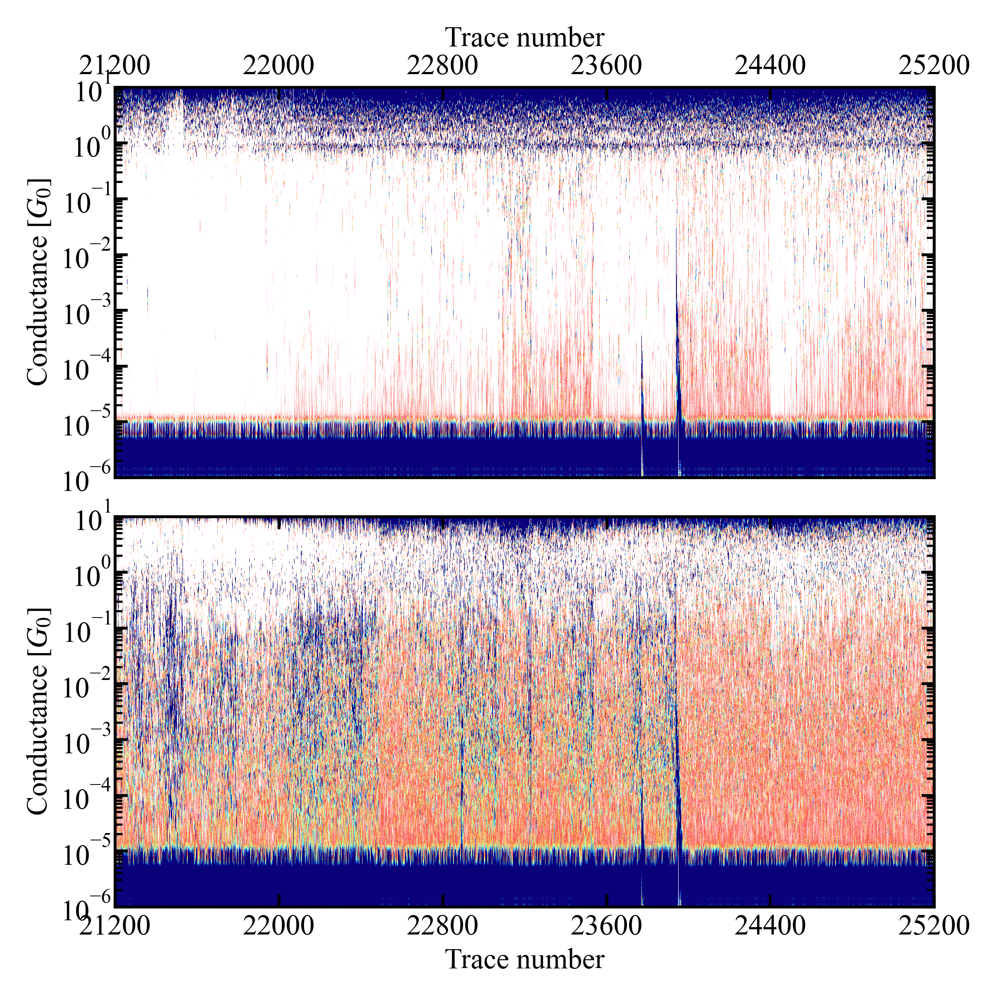

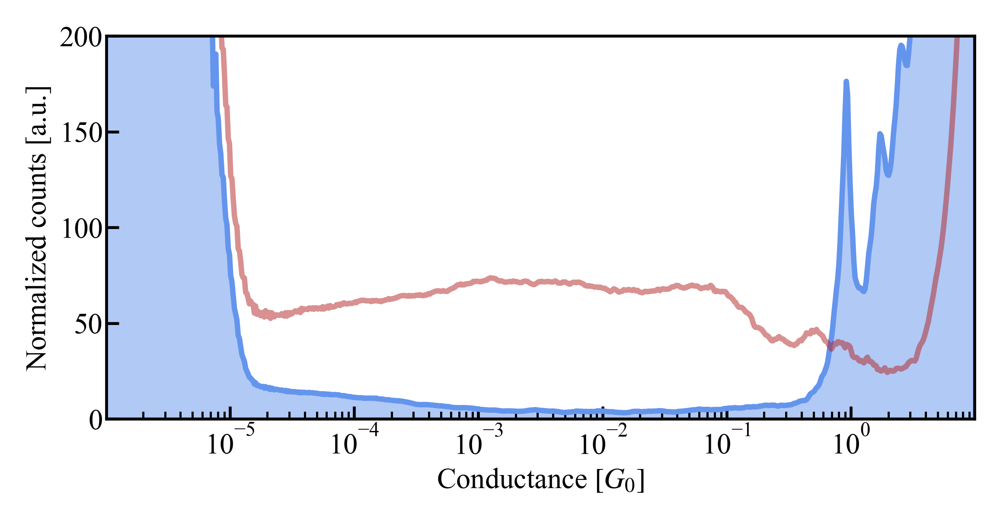

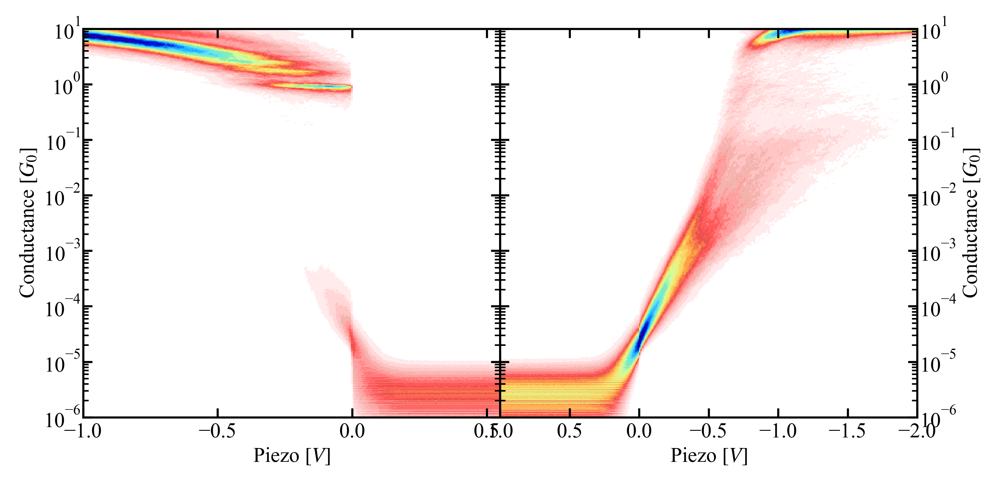

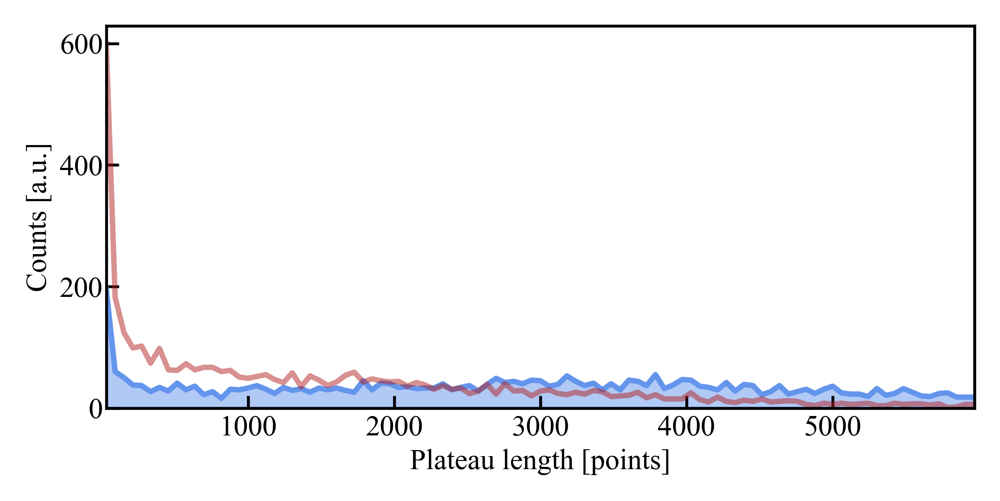

In [11]:
ax_temp_pull, ax_temp_push = hist_3.plot_temporal_hist(vmax=200)
ax_temp_pull.set_xticks(np.linspace(0, 4000, 6).astype(int))
ax_temp_pull.set_xticklabels(np.linspace(21200, 25200, 6).astype(int))
ax_temp_push.set_xticks(np.linspace(0, 4000, 6).astype(int))
ax_temp_push.set_xticklabels(np.linspace(21200, 25200, 6).astype(int))
ax_1d = hist_3.plot_hist_1d(ylims=(0, 200))
ax_pull, ax_push = hist_3.plot_hist_2d_both()
ax_plat = hist_3.plot_plateau_length_hist()

In [12]:
hist_3.calc_hist_2d(align_at=0.5, range_pull=(-0.5, 0.55), range_push=(-0.5, 1.5),
                    xbins_pull=200, xbins_push=250)

Calculating 2D conductance-displacement histograms:   0%|          | 0/41 [00:00<?, ?it/s]

2D histogram pull direction created from 3997 traces
2D histogram push direction created from 3999 traces


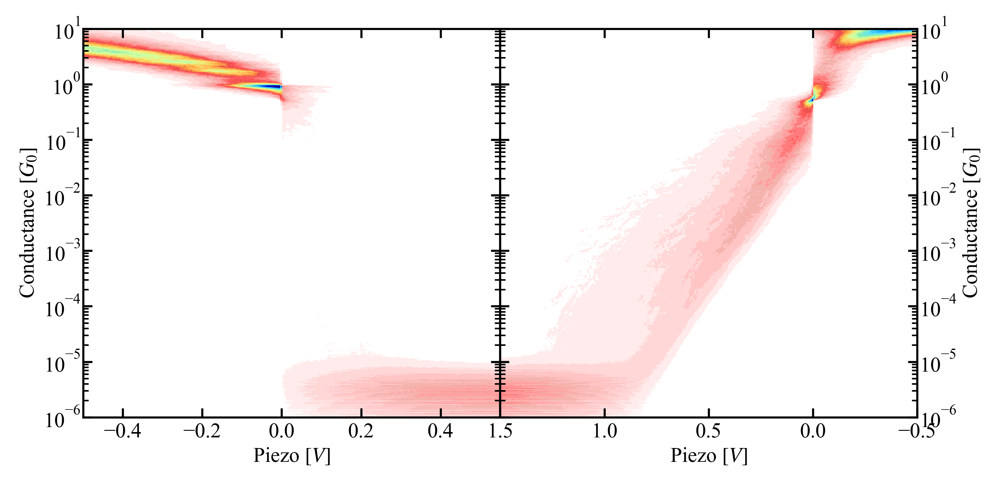

In [13]:
ax_pull, ax_push = hist_3.plot_hist_2d_both()

***

# I(V) measurements

## Details

**bias waveform**: *custom_IV_mcbj_with_wait.ini*

**IV bias range**: $\pm 1\;\text{V}$

added 500 ms long 100 mV wait in the beginning to account for relaxation

## 25201-28500    rate=2

### Filtering traces that did not break during the hold measurement

In [82]:
did_not_break_pull, did_not_break_push = filter_traces.filter_hold(home_folder,
                                                                   filter_condition=filter_traces.does_not_break_array,
                                                                   start_trace=25201, end_trace=28500,
                                                                   bias_offset=0, r_serial_ohm=99_900,
                                                                   min_step_len=20_000)

Filtering traces:   0%|          | 0/34 [00:00<?, ?it/s]

In [83]:
print('pull', len(did_not_break_pull))
print('push', len(did_not_break_push))

pull 69
push 3299


### Filtering traces where the conductance on the two 200 mV bias plateaus do not differ more than a factor of 2

In [84]:
stable_pull, stable_push = filter_traces.filter_hold(home_folder, filter_condition=filter_traces.conductances_close,
                                                     start_trace=25201, end_trace=28500,
                                                     bias_offset=0, r_serial_ohm=99_900,
                                                     min_step_len=20_000, max_ratio=2, plateaus=(1, 3))

Filtering traces:   0%|          | 0/34 [00:00<?, ?it/s]

In [85]:
print('pull', len(stable_pull))
print('push', len(stable_push))

pull 2280
push 3206


In [86]:
pull_traces = np.intersect1d(did_not_break_pull, stable_pull)
push_traces = np.intersect1d(did_not_break_push, stable_push)

In [87]:
print(f'pull: {len(pull_traces)}, {len(pull_traces)/3300*100}%')
print(f'push: {len(push_traces)}, {len(push_traces)/3300*100}%')

pull: 60, 1.8181818181818181%
push: 3206, 97.15151515151516%


In [89]:
np.save(home_folder.joinpath('results/pull_filtered_traces_rate_2.npy'), pull_traces)
np.save(home_folder.joinpath('results/push_filtered_traces_rate_2.npy'), push_traces)

In [92]:
pull_traces = np.load(home_folder.joinpath('results/pull_filtered_traces_rate_2.npy'))
push_traces = np.load(home_folder.joinpath('results/push_filtered_traces_rate_2.npy'))

The amount of pull traces is not significant, so from now on focus on push traces.

We are interested in the I(V) curves where the up-down sweeps overlap nicely. The difference between the up-down sweeps is calculated with the function `filter_traces.iv_difference`

In [93]:
push_diff = []
traces = []
for which_trace in tqdm(push_traces):
    try:
        hold_trace = HoldTrace(which_trace, load_from=home_folder, bias_offset=0,
                               r_serial_ohm=99_900, min_step_len=20_000, min_height=1, iv=1)
        push_diff.append(filter_traces.iv_difference(hold_trace, direction='push', smoothing=100))
        traces.append(hold_trace.trace_num)
    except MeasurementOverflow:
        continue
    
push_diff = np.array(push_diff)
traces = np.array(traces)

  0%|          | 0/3206 [00:00<?, ?it/s]

522 17.575757575757574


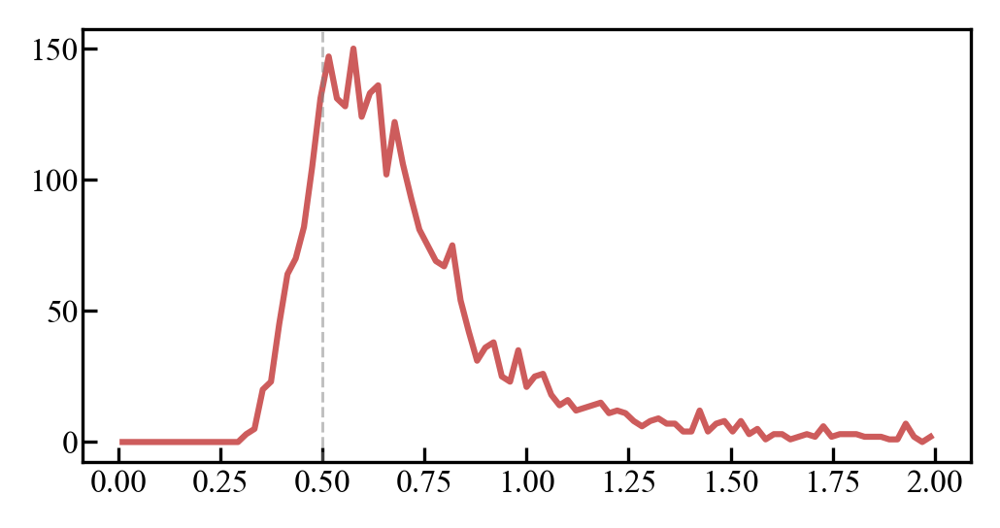

In [94]:
push_diff_bins, push_diff_hist = utils.calc_hist_1d_single(data=push_diff, xrange=(0, 2),
                                                           xbins_num=100, log_scale=False)

print(len(push_diff[push_diff < 0.5]), len(push_diff[push_diff < 0.5])/len(push_diff)*100)

fig, ax = plt.subplots(1, figsize=utils.cm2inch(10, 5), dpi=300)
ax.plot(push_diff_bins, push_diff_hist, 'indianred')
ax.axvline(0.5, c='grey', alpha=0.5, ls='--', lw=0.7)

In [96]:
selected_traces = traces[push_diff < 0.5]
np.save(home_folder.joinpath('results/push_selected_traces_IV_rate_2.npy'), selected_traces)

In [51]:
selected_traces = np.load(home_folder.joinpath('results/push_selected_traces_IV_rate_2.npy'))

Plotted trace: 26242
0.47447633733686245


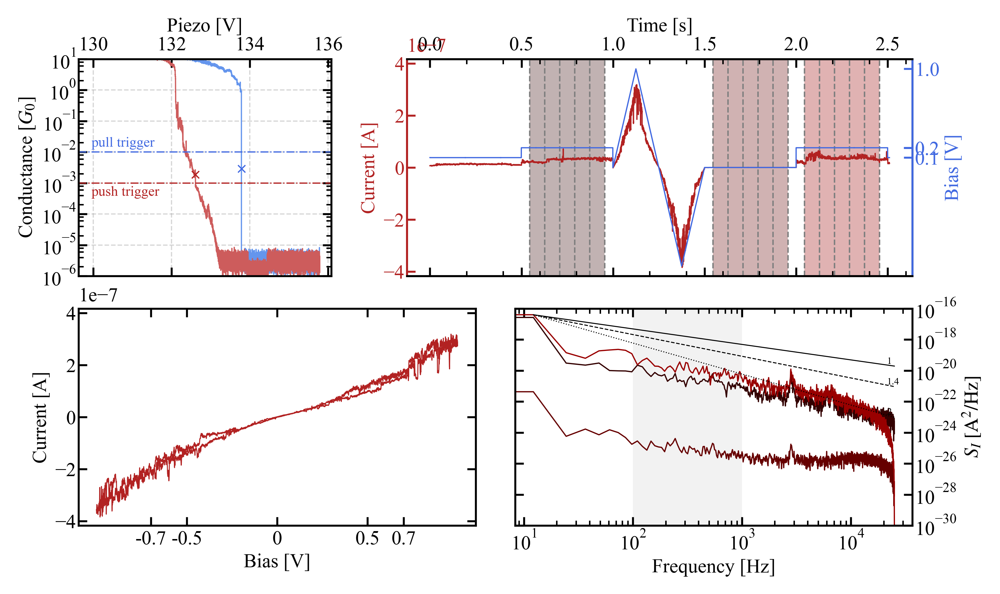

In [55]:
which_trace = np.random.choice(selected_traces)
# which_trace = 25359
print(f'Plotted trace: {which_trace}')

hold_trace = HoldTrace(which_trace,
                       load_from=home_folder, bias_offset=0,
                       r_serial_ohm=99_900, min_step_len=20_000, min_height=1, iv=1)

trace_pair = TracePair(which_trace, load_from=home_folder)

hold_trace.analyse_hold_trace(num_of_fft=5, subtract_bg=True)
plots.plot_ivs_scheme_one(trace_pair=trace_pair, hold_trace=hold_trace, direction='push', which_psds=[1, 2, 3],
                         smoothing=10)

print(filter_traces.iv_difference(hold_trace, direction='push', smoothing=100))

In [47]:
hold_trace.avg_cond_on_step_push

array([0.00470713, 0.00610948, 0.00486644])

In [3]:
selected_traces.shape

(522,)

***

In [4]:
hist_filt_2 = Histogram(home_folder, traces=selected_traces)

hist_filt_2.calc_stats(align_at=1e-5, range_pull=(-0.8, 0.55), range_push=(-3, 1), xbins_pull=250, xbins_push=400,
                       plateau_length_bins=100)

  0%|          | 0/522 [00:00<?, ?it/s]

Pull 2D histogram created from 522 traces
Push 2D histogram created from 522 traces


In [12]:
tunnel_slope_2_df = pd.read_csv(home_folder.joinpath('results/IVs/selected/rate_2/fit_tunnel_rate_2.csv'))

In [15]:
tunnel_slope_2_df.slope.mean()

3.8864657516331027

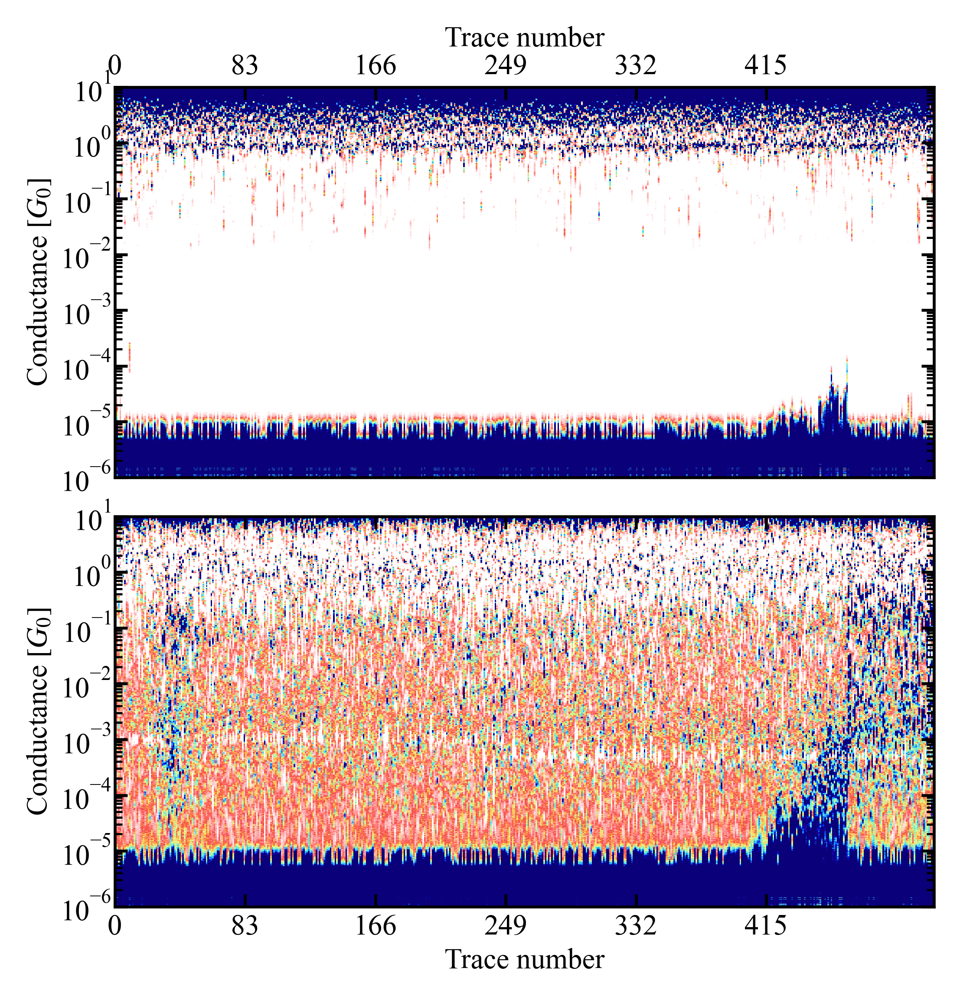

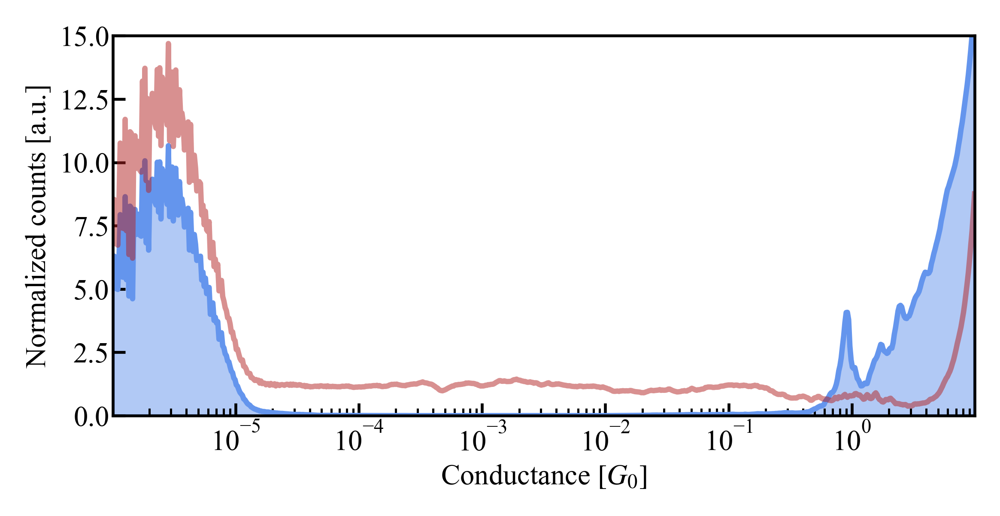

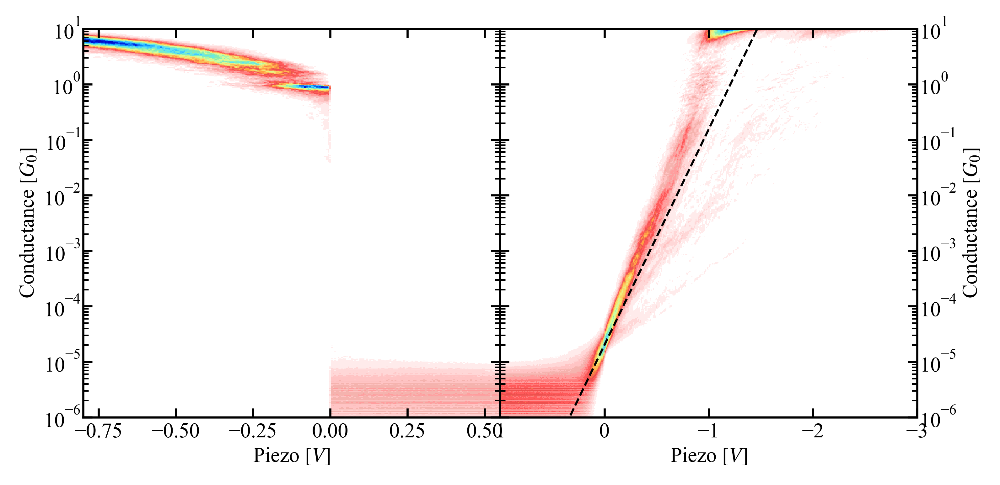

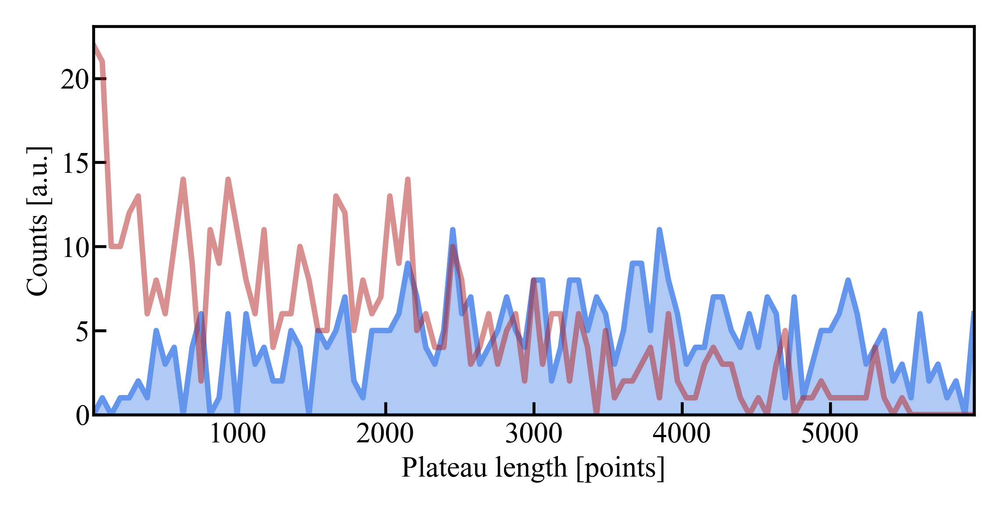

In [40]:
ax_temp_pull, ax_temp_push = hist_filt_2.plot_temporal_hist(vmax=200)
ax_temp_pull.set_xticks(np.linspace(0, len(selected_traces), 6).astype(int))
ax_temp_pull.set_xticklabels(np.linspace(0, len(selected_traces), 6).astype(int))
ax_temp_push.set_xticks(np.linspace(0, len(selected_traces), 6).astype(int))
ax_temp_push.set_xticklabels(np.linspace(0, len(selected_traces), 6).astype(int))
ax_1d = hist_filt_2.plot_hist_1d(ylims=(0, 15))
ax_pull, ax_push = hist_filt_2.plot_hist_2d_both()
ax_push.plot(np.arange(start=-3, stop=1, step=0.2),
             10**(-tunnel_slope_2_df.slope.mean()*np.arange(start=-3, stop=1, step=0.2)-4.7), ls='--', lw=0.8, c='k')
ax_plat = hist_filt_2.plot_plateau_length_hist()

***

### For those traces that did not break and were stable throughout the measurement an I(V) is good (521 traces)

In [25]:
noise_stat = NoiseStats(home_folder, traces=selected_traces, num_of_fft=5, bias_offset=0,
                        min_step_len=20_000, min_height=1, subtract_bg=False, save_data=1)

Processing hold files:   0%|          | 0/34 [00:00<?, ?it/s]

Data saved.


In [49]:
noise_stat = NoiseStats(home_folder, traces=selected_traces, num_of_fft=5, bias_offset=0,
                        min_step_len=20_000, min_height=1, subtract_bg=True, save_data=2)

Processing hold files:   0%|          | 0/34 [00:00<?, ?it/s]

Data saved.


In [27]:
# pd.read_csv(home_folder.joinpath("results/noise_stats_push_2.csv")).head(1)

In [28]:
noise_stat_push = pd.read_csv(home_folder.joinpath("results/noise_stats_push_2.csv"), skiprows=[1])

In [29]:
# noise_stat_push.head()

#### After subtracting the background

#### First 200 mV plateau:

In [30]:
step=2

N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push[f'noise_power_{step}']/ \
                                                   noise_stat_push[f'avg_cond_on_step_{step}']**n),
                                          np.log10(noise_stat_push[f'avg_cond_on_step_{step}']))

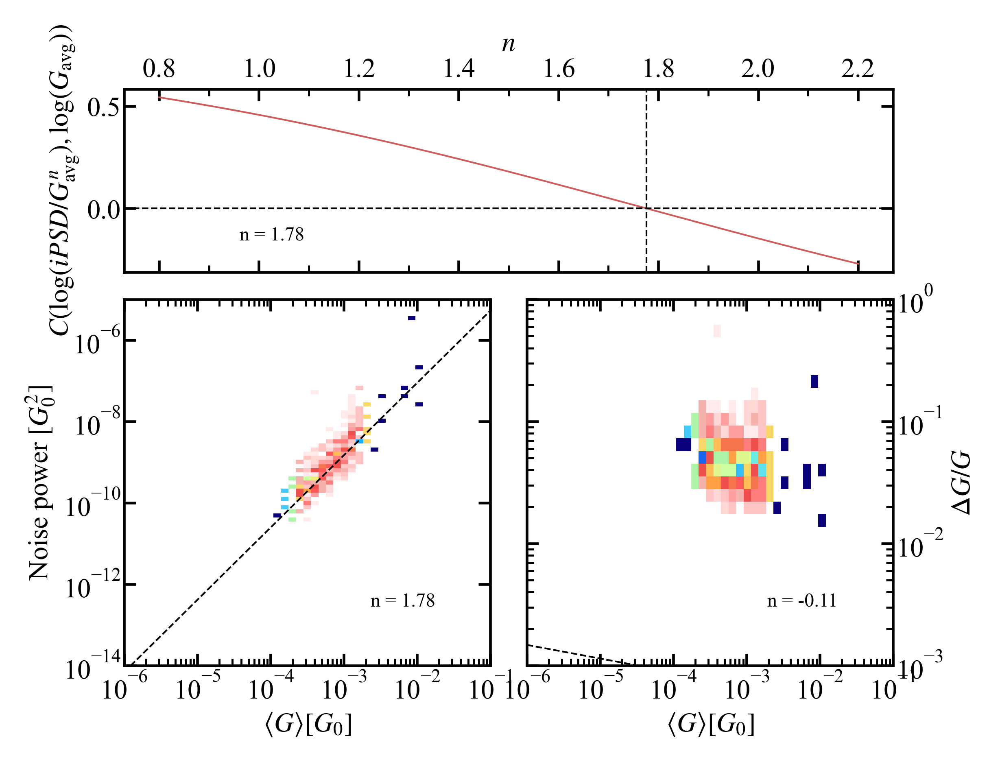

In [31]:
ax_corr, ax_corrhist_1, ax_corrhist_2 = plots.plot_noise_power(N=N, corr=push_corr,
                                                               source=noise_stat_push,
                                                               step=step,
                                                               direction='push', vmax=0.5)

***

#### Second 200 mV plateau:

In [32]:
step=3

N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push[f'noise_power_{step}']/ \
                                                   noise_stat_push[f'avg_cond_on_step_{step}']**n),
                                          np.log10(noise_stat_push[f'avg_cond_on_step_{step}']))

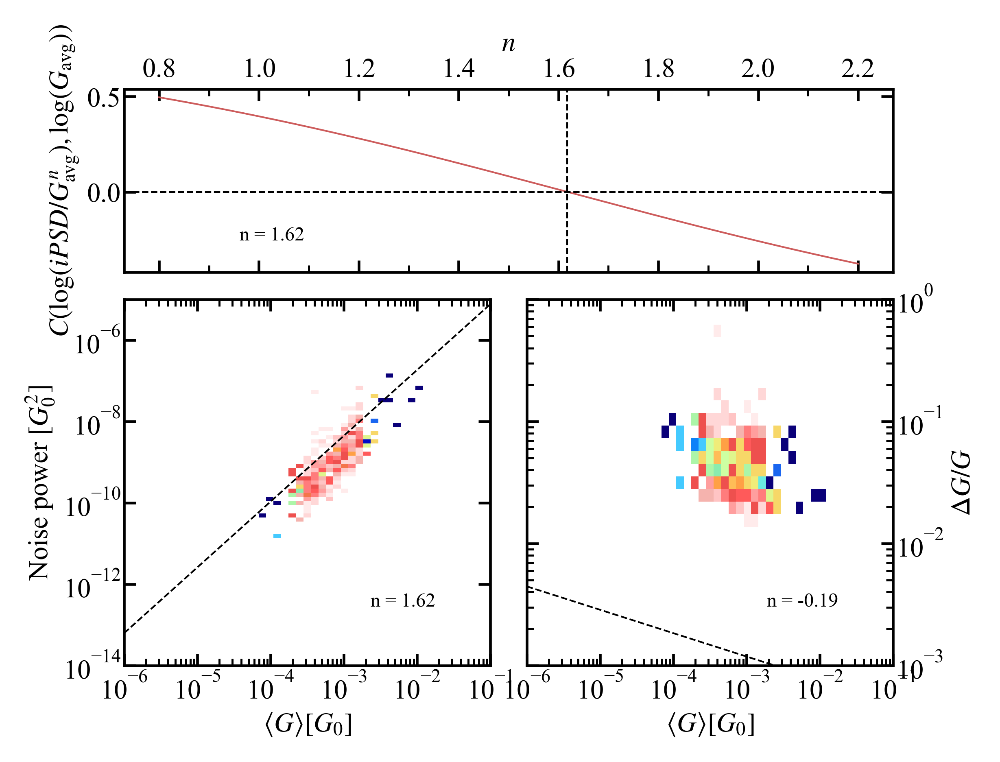

In [33]:
ax_corr, ax_corrhist_1, ax_corrhist_2 = plots.plot_noise_power(N=N, corr=push_corr,
                                                               source=noise_stat_push,
                                                               step=step,
                                                               direction='push', vmax=0.5)

***

In [34]:
hist_filt_1 = Histogram(home_folder, traces=selected_traces)

hist_filt_1.calc_stats(align_at=1e-5, range_pull=(-0.8, 0.55), range_push=(-3, 1), xbins_pull=250, xbins_push=400,
                       plateau_length_bins=100)

  0%|          | 0/415 [00:00<?, ?it/s]

Pull 2D histogram created from 415 traces
Push 2D histogram created from 415 traces


In [35]:
tunnel_slope_1_df = pd.read_csv(home_folder.joinpath('results/IVs/selected/rate_1/fit_tunnel_rate_1.csv'))

In [36]:
tunnel_slope_1_df.slope.mean()

3.8970649183695043

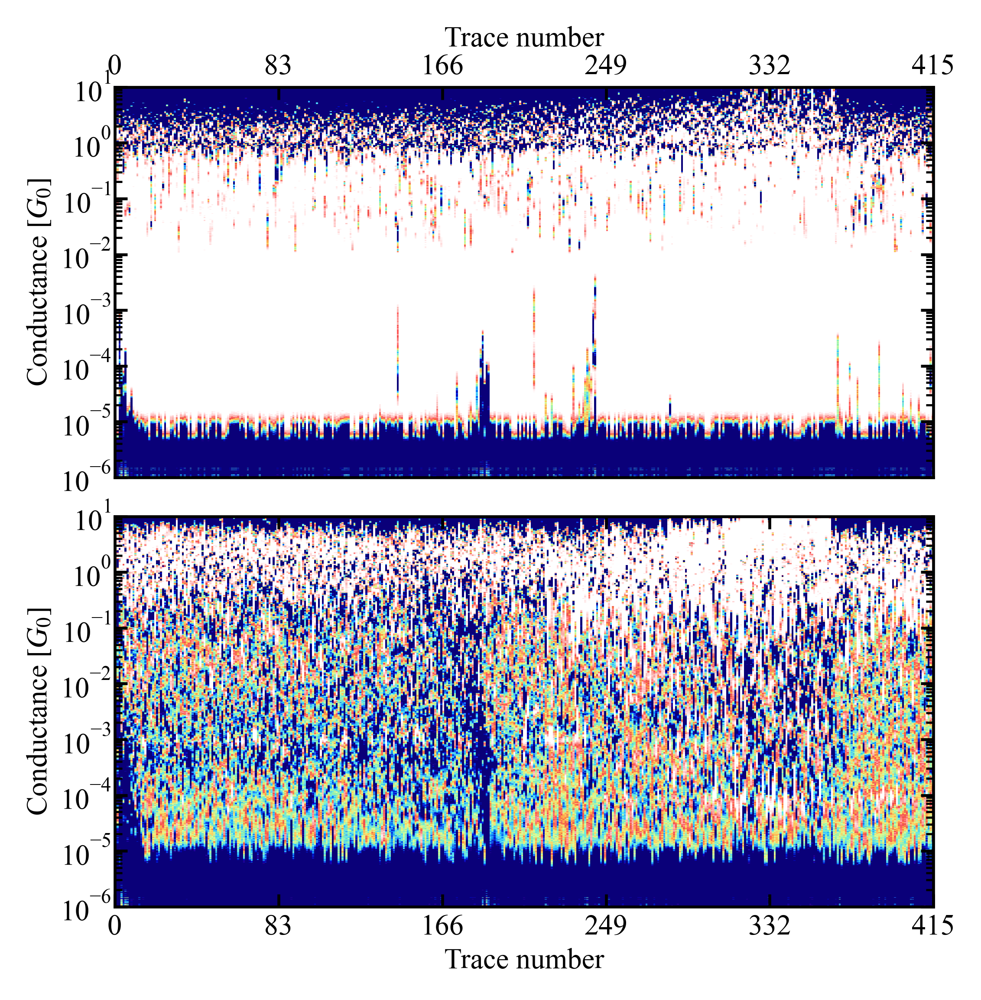

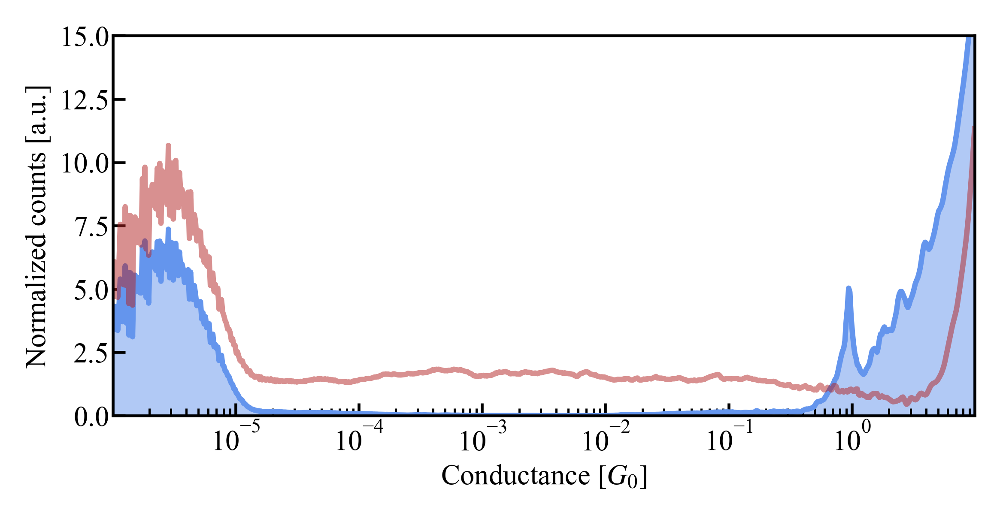

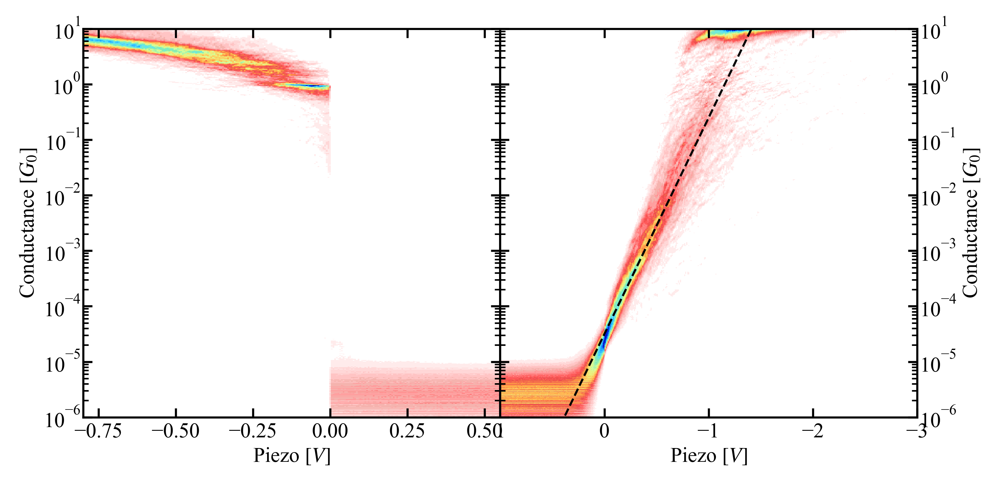

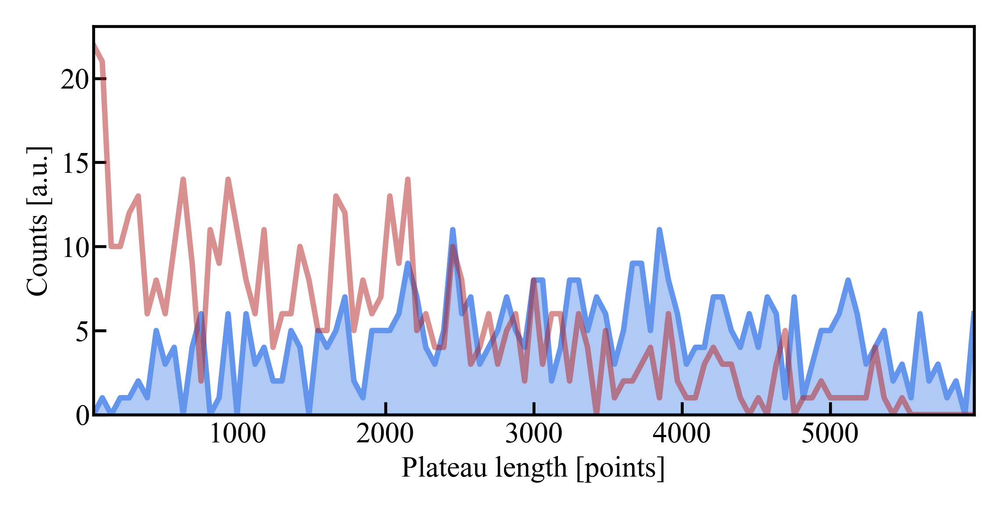

In [41]:
ax_temp_pull, ax_temp_push = hist_filt_1.plot_temporal_hist(vmax=200)
ax_temp_pull.set_xticks(np.linspace(0, len(selected_traces), 6).astype(int))
ax_temp_pull.set_xticklabels(np.linspace(0, len(selected_traces), 6).astype(int))
ax_temp_push.set_xticks(np.linspace(0, len(selected_traces), 6).astype(int))
ax_temp_push.set_xticklabels(np.linspace(0, len(selected_traces), 6).astype(int))
ax_1d = hist_filt_1.plot_hist_1d(ylims=(0, 15))
ax_pull, ax_push = hist_filt_1.plot_hist_2d_both()
ax_push.plot(np.arange(start=-3, stop=1, step=0.2),
             10**(-tunnel_slope_1_df.slope.mean()*np.arange(start=-3, stop=1, step=0.2)-4.5), ls='--', lw=0.8, c='k')
ax_plat = hist_filt_2.plot_plateau_length_hist()

***

### For all traces that did not break and were stable throughout the measurement (3206 traces)

In [34]:
noise_stat = NoiseStats(home_folder, traces=push_traces, num_of_fft=5, bias_offset=0,
                        min_step_len=20_000, min_height=1, subtract_bg=False, save_data=3)

Processing hold files:   0%|          | 0/34 [00:00<?, ?it/s]

Data saved.
During the analysis the following errors occurred:
Overflow at trace_25254


In [35]:
noise_stat = NoiseStats(home_folder, traces=push_traces, num_of_fft=5, bias_offset=0,
                        min_step_len=20_000, min_height=1, subtract_bg=True, save_data=4)

Processing hold files:   0%|          | 0/34 [00:00<?, ?it/s]

Data saved.
During the analysis the following errors occurred:
Overflow at trace_25254


#### After subtracting the background

#### First 200 mV plateau:

In [36]:
noise_stat_push = pd.read_csv(home_folder.joinpath("results/noise_stats_push_4.csv"), skiprows=[1])

In [37]:
step=2

N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push[f'noise_power_{step}']/ \
                                                   noise_stat_push[f'avg_cond_on_step_{step}']**n),
                                          np.log10(noise_stat_push[f'avg_cond_on_step_{step}']))

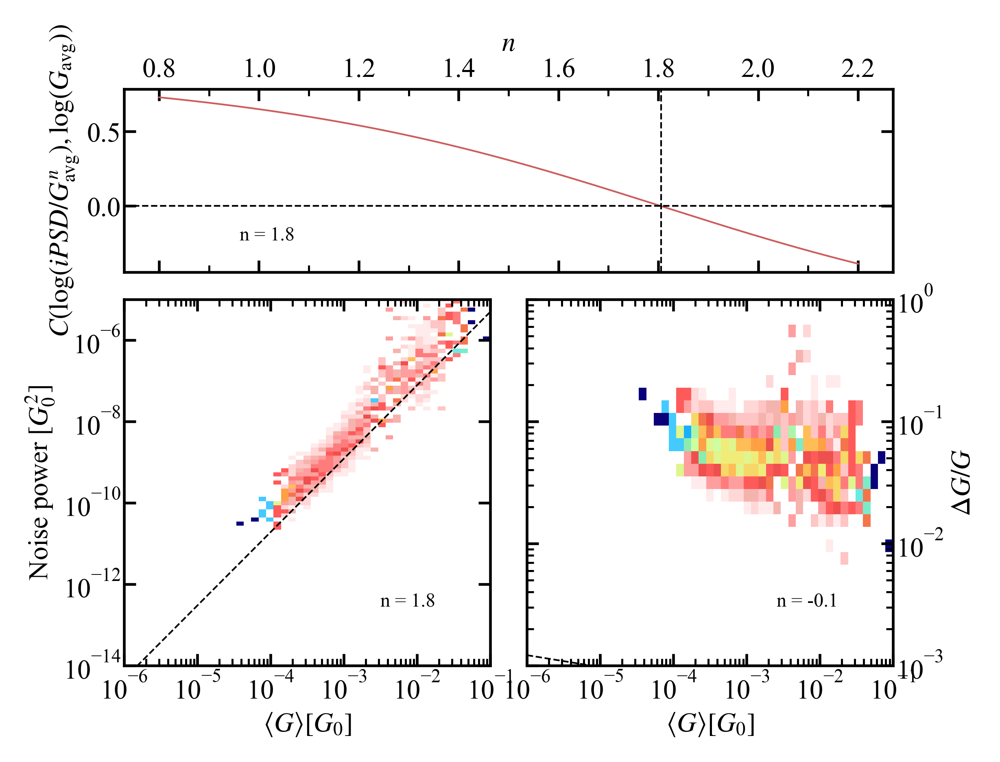

In [38]:
ax_corr, ax_corrhist_1, ax_corrhist_2 = plots.plot_noise_power(N=N, corr=push_corr,
                                                               source=noise_stat_push,
                                                               step=step,
                                                               direction='push', vmax=0.5)

***

#### Second 200 mV plateau:

In [39]:
step=3

N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push[f'noise_power_{step}']/ \
                                                   noise_stat_push[f'avg_cond_on_step_{step}']**n),
                                          np.log10(noise_stat_push[f'avg_cond_on_step_{step}']))

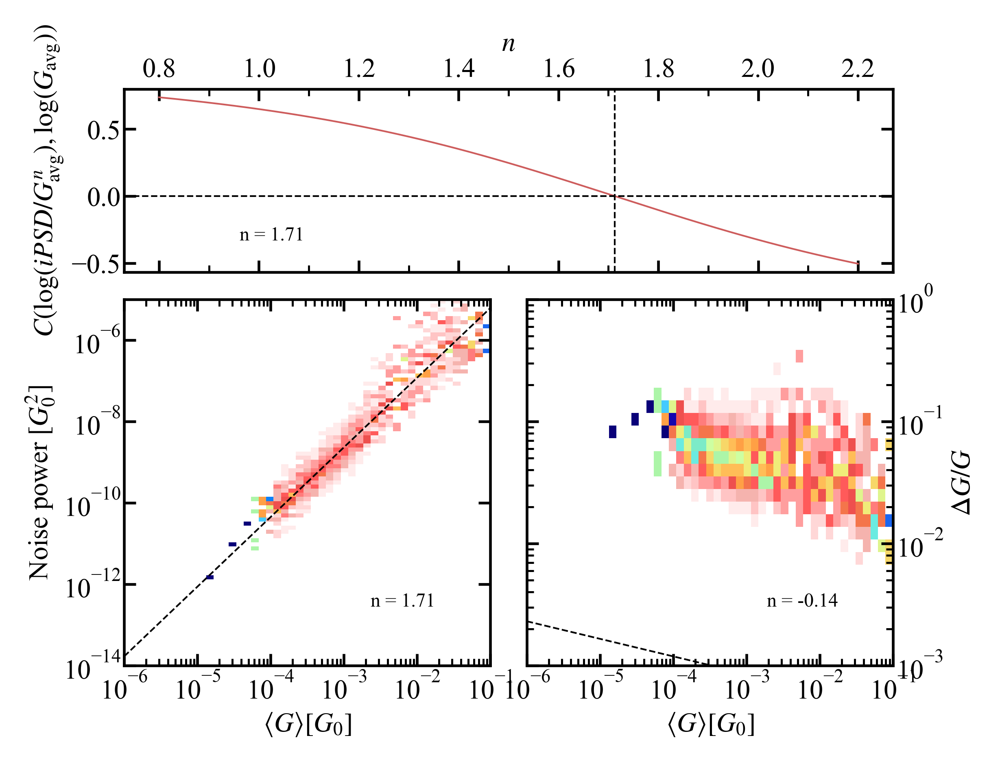

In [40]:
ax_corr, ax_corrhist_1, ax_corrhist_2 = plots.plot_noise_power(N=N, corr=push_corr,
                                                               source=noise_stat_push,
                                                               step=step,
                                                               direction='push', vmax=0.5)

### BJ tunnel linear fit

In [41]:
fit_params = []
fit_errors = []

for trace in tqdm(selected_traces):
    trace_pair = TracePair(trace, load_from=home_folder)
    popt, perr = trace_pair.fit_tunnel()
    
    fit_params.append(popt)
    fit_errors.append(perr)
    
fit_params = np.array(fit_params)
fit_errors = np.array(fit_errors)

  0%|          | 0/522 [00:00<?, ?it/s]

In [42]:
tunnel_slope_2_df = pd.DataFrame({'trace': selected_traces,
                                  'slope': fit_params[:, 0], 
                                  'slope error': fit_errors[:, 0],
                                  'intercept': fit_params[:, 1],
                                  'intercept_error': fit_errors[:, 1]
                                 })

tunnel_slope_2_df.to_csv(home_folder.joinpath('results/IVs/selected/rate_2/fit_tunnel.csv'), index=False)

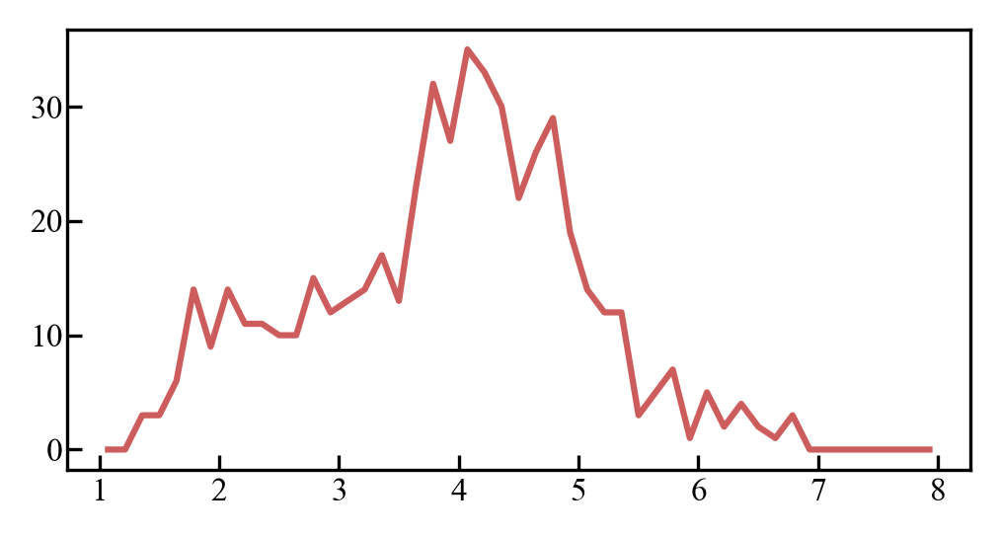

In [43]:
fit_params_bins, fit_params_hist = utils.calc_hist_1d_single(data=fit_params[:, 0], xrange=(1, 8),
                                                             xbins_num=50, log_scale=False)


fig, ax = plt.subplots(1, figsize=utils.cm2inch(10, 5), dpi=300)
ax.plot(fit_params_bins, fit_params_hist, 'indianred')
# ax.axvline(0.5, c='grey', alpha=0.5, ls='--', lw=0.7)

### Save I(V) curves in Laci's format

In [44]:
for which_trace in tqdm(selected_traces):
    hold_trace = HoldTrace(which_trace,
                           load_from=home_folder, bias_offset=0,
                           r_serial_ohm=99_900, min_step_len=20_000, min_height=1, iv=1, gain=1e7)
    hold_trace.save_iv_for_laci(home_folder, direction='push')

  0%|          | 0/522 [00:00<?, ?it/s]

***

## 28501-34200 rate=1

### Filtering traces that did not break during the hold measurement

In [98]:
did_not_break_pull, did_not_break_push = filter_traces.filter_hold(home_folder,
                                                                   filter_condition=filter_traces.does_not_break_array,
                                                                   start_trace=28501, end_trace=32600,
                                                                   bias_offset=0, r_serial_ohm=99_900,
                                                                   min_step_len=20_000)

Filtering traces:   0%|          | 0/42 [00:00<?, ?it/s]

In [99]:
print('pull', len(did_not_break_pull))
print('push', len(did_not_break_push))

pull 254
push 3679


### Filtering traces where the conductance on the two 200 mV bias plateaus do not differ more than a factor of 2


In [100]:
stable_pull, stable_push = filter_traces.filter_hold(home_folder, filter_condition=filter_traces.conductances_close,
                                                     start_trace=28501, end_trace=32600,
                                                     bias_offset=0, r_serial_ohm=99_900,
                                                     min_step_len=20_000, max_ratio=2, plateaus=(1, 3))

Filtering traces:   0%|          | 0/42 [00:00<?, ?it/s]

In [101]:
print('pull', len(stable_pull))
print('push', len(stable_push))

pull 1927
push 3940


In [102]:
pull_traces = np.intersect1d(did_not_break_pull, stable_pull)
push_traces = np.intersect1d(did_not_break_push, stable_push)

In [103]:
print(f'pull: {len(pull_traces)}, {len(pull_traces)/4100*100}%')
print(f'push: {len(push_traces)}, {len(push_traces)/4100*100}%')

pull: 180, 4.390243902439024%
push: 3602, 87.85365853658537%


In [104]:
np.save(home_folder.joinpath('results/pull_filtered_traces_rate_1.npy'), pull_traces)
np.save(home_folder.joinpath('results/push_filtered_traces_rate_1.npy'), push_traces)

In [105]:
pull_traces = np.load(home_folder.joinpath('results/pull_filtered_traces_rate_1.npy'))
push_traces = np.load(home_folder.joinpath('results/push_filtered_traces_rate_1.npy'))

Iterate through those traces that did not break and are stable. Collect those where I(V) curves do not differ too much in the up-down sweep directions.

In [106]:
push_diff = []
traces = []
for which_trace in tqdm(push_traces):
    try:
        hold_trace = HoldTrace(which_trace, load_from=home_folder, bias_offset=0,
                               r_serial_ohm=99_900, min_step_len=20_000, min_height=1, iv=1)
        push_diff.append(filter_traces.iv_difference(hold_trace, direction='push', smoothing=100))
        traces.append(hold_trace.trace_num)
    except MeasurementOverflow:
        continue
    
push_diff = np.array(push_diff)
traces = np.array(traces)

  0%|          | 0/3602 [00:00<?, ?it/s]

415 11.572783045175683


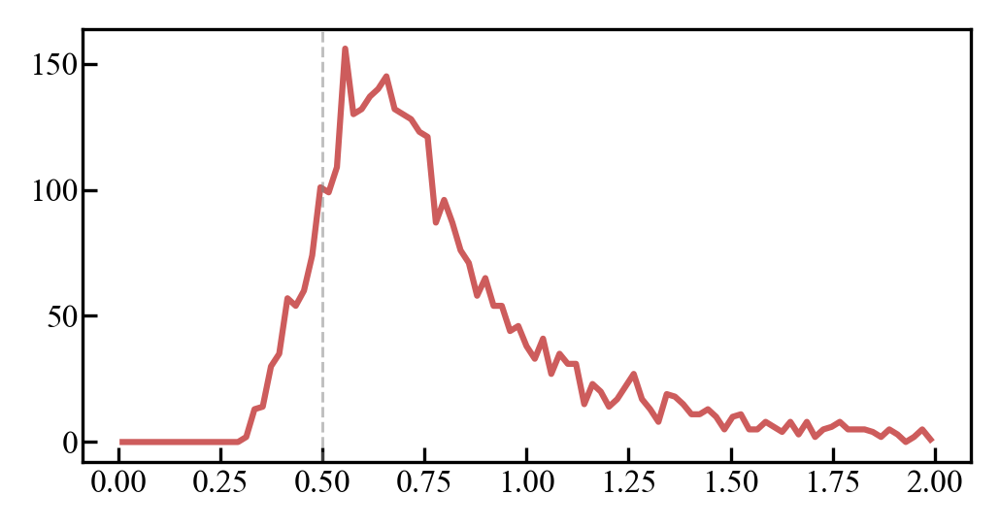

In [107]:
push_diff_bins, push_diff_hist = utils.calc_hist_1d_single(data=push_diff, xrange=(0, 2),
                                                           xbins_num=100, log_scale=False)

print(len(push_diff[push_diff < 0.5]), len(push_diff[push_diff < 0.5])/len(push_diff)*100)

fig, ax = plt.subplots(1, figsize=utils.cm2inch(10, 5), dpi=300)
ax.plot(push_diff_bins, push_diff_hist, 'indianred')
ax.axvline(0.5, c='grey', alpha=0.5, ls='--', lw=0.7)

In [109]:
selected_traces = traces[push_diff < 0.5]
np.save(home_folder.joinpath('results/push_selected_traces_IV_rate_1.npy'), selected_traces)

In [32]:
selected_traces = np.load(home_folder.joinpath('results/push_selected_traces_IV_rate_1.npy'))

In [33]:
print(selected_traces.shape)

(415,)


Plotted trace: 28528
0.49845964759171546


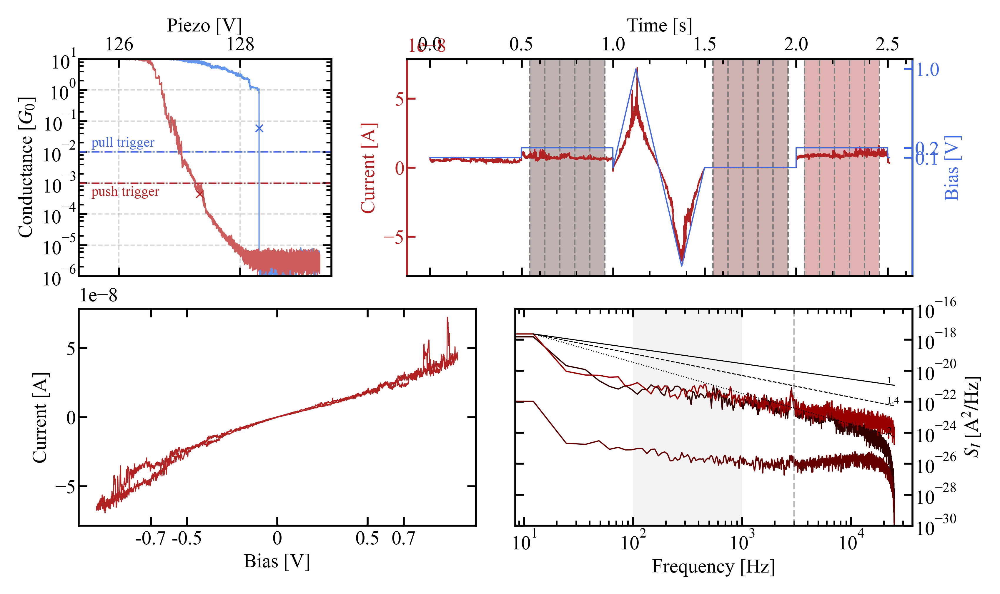

In [55]:
which_trace = np.random.choice(selected_traces)
print(f'Plotted trace: {which_trace}')

hold_trace = HoldTrace(which_trace,
                       load_from=home_folder, bias_offset=0,
                       r_serial_ohm=99_900, min_step_len=20_000, min_height=1, iv=1)

trace_pair = TracePair(which_trace, load_from=home_folder)

hold_trace.analyse_hold_trace(num_of_fft=5, subtract_bg=True)
ax_trace, ax_hold, par_hold, ax_iv, ax_psd = plots.plot_ivs_scheme_one(trace_pair=trace_pair, hold_trace=hold_trace, direction='push', which_psds=[1, 2, 3], smoothing=10)

ax_psd.axvline(3000, c='grey', alpha=0.5, lw=0.7, ls='--')

print(filter_traces.iv_difference(hold_trace, direction='push', smoothing=100))

***

### For those traces that did not break and were stable throughout the measurement an I(V) is good (415 traces)

In [56]:
noise_stat = NoiseStats(home_folder, traces=selected_traces, num_of_fft=5, bias_offset=0,
                        min_step_len=20_000, min_height=1, subtract_bg=False, save_data=5)

Processing hold files:   0%|          | 0/41 [00:00<?, ?it/s]

Data saved.


In [57]:
noise_stat = NoiseStats(home_folder, traces=selected_traces, num_of_fft=5, bias_offset=0,
                        min_step_len=20_000, min_height=1, subtract_bg=True, save_data=6)

Processing hold files:   0%|          | 0/41 [00:00<?, ?it/s]

Data saved.


In [58]:
noise_stat_push = pd.read_csv(home_folder.joinpath("results/noise_stats_push_6.csv"), skiprows=[1])

#### First 200 mV plateau

In [59]:
step=2

N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push[f'noise_power_{step}']/ \
                                                   noise_stat_push[f'avg_cond_on_step_{step}']**n),
                                          np.log10(noise_stat_push[f'avg_cond_on_step_{step}']))

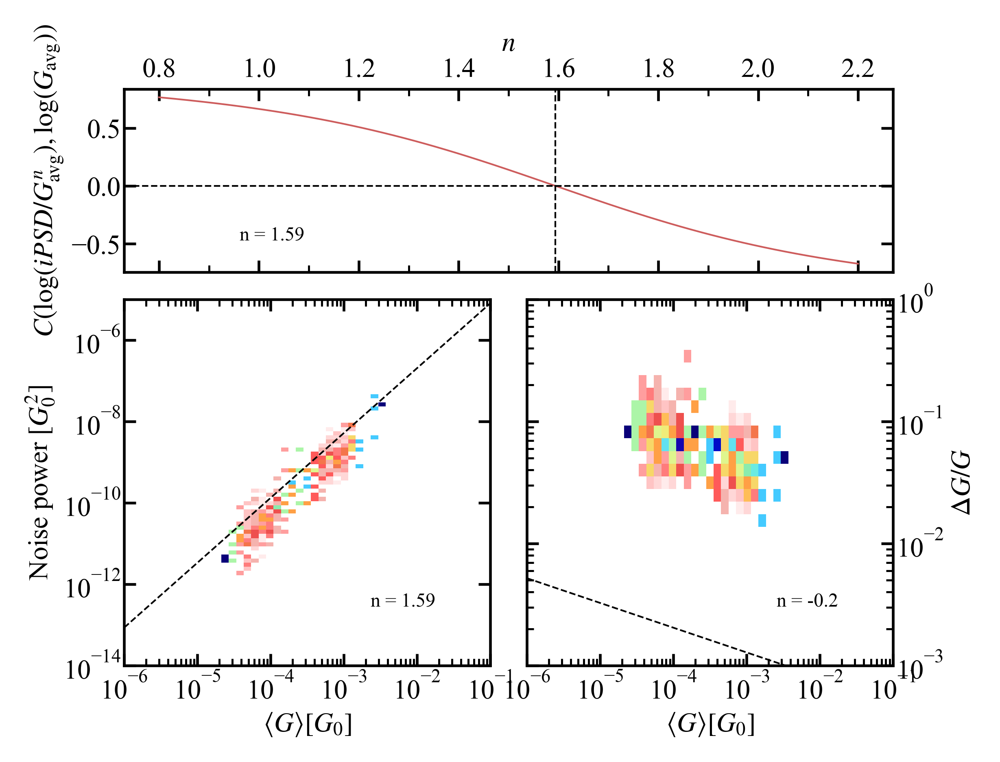

In [60]:
ax_corr, ax_corrhist_1, ax_corrhist_2 = plots.plot_noise_power(N=N, corr=push_corr,
                                                               source=noise_stat_push,
                                                               step=step,
                                                               direction='push', vmax=0.5)

***

#### Second 200 mV plateau

In [61]:
step=3

N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push[f'noise_power_{step}']/ \
                                                   noise_stat_push[f'avg_cond_on_step_{step}']**n),
                                          np.log10(noise_stat_push[f'avg_cond_on_step_{step}']))

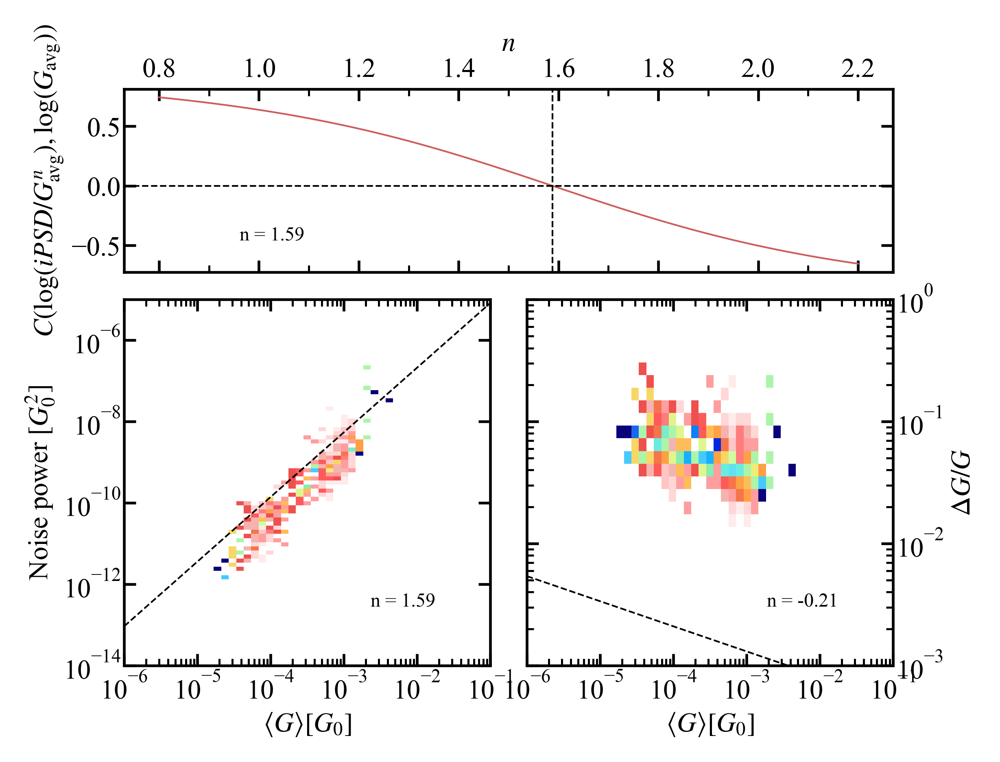

In [62]:
ax_corr, ax_corrhist_1, ax_corrhist_2 = plots.plot_noise_power(N=N, corr=push_corr,
                                                               source=noise_stat_push,
                                                               step=step,
                                                               direction='push', vmax=0.5)

***

### For all traces that did not break and were stable throughout the measurement (3597 traces)

In [63]:
noise_stat = NoiseStats(home_folder, traces=push_traces, num_of_fft=5, bias_offset=0,
                        min_step_len=20_000, min_height=1, subtract_bg=False, save_data=7)

Processing hold files:   0%|          | 0/42 [00:00<?, ?it/s]

Data saved.


In [64]:
noise_stat = NoiseStats(home_folder, traces=push_traces, num_of_fft=5, bias_offset=0,
                        min_step_len=20_000, min_height=1, subtract_bg=True, save_data=8)

Processing hold files:   0%|          | 0/42 [00:00<?, ?it/s]

Data saved.


In [65]:
noise_stat_push = pd.read_csv(home_folder.joinpath("results/noise_stats_push_8.csv"), skiprows=[1])

#### First 200 mV plateau

In [66]:
step=2

N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push[f'noise_power_{step}']/ \
                                                   noise_stat_push[f'avg_cond_on_step_{step}']**n),
                                          np.log10(noise_stat_push[f'avg_cond_on_step_{step}']))

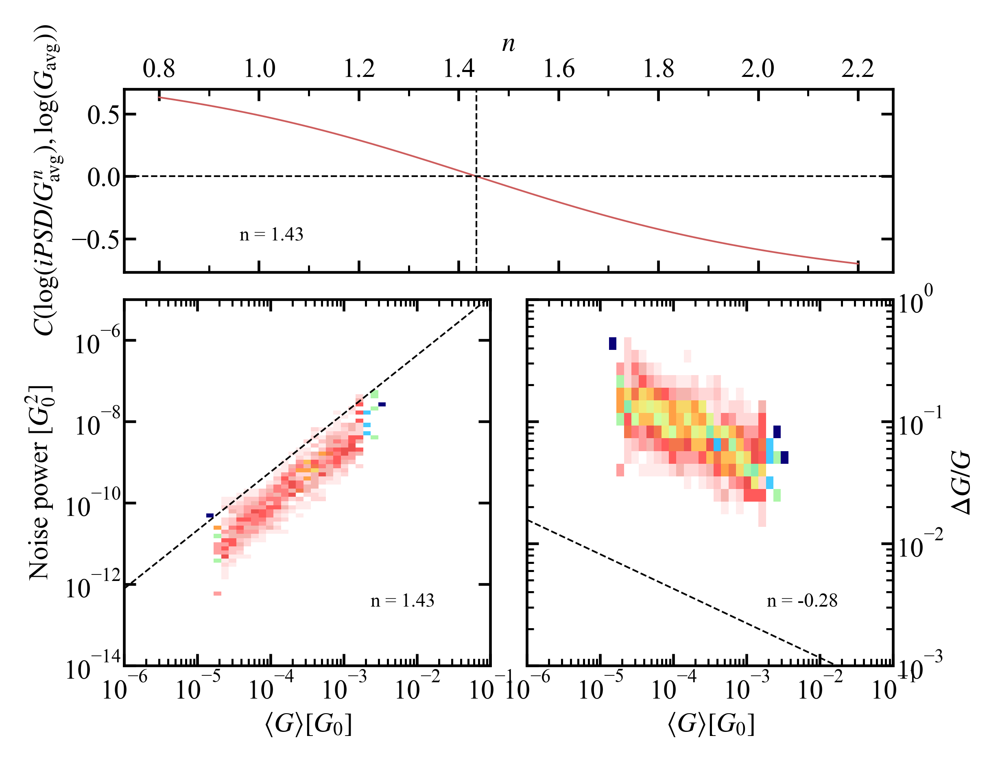

In [67]:
ax_corr, ax_corrhist_1, ax_corrhist_2 = plots.plot_noise_power(N=N, corr=push_corr,
                                                               source=noise_stat_push,
                                                               step=step,
                                                               direction='push', vmax=0.5)

***

#### Second 200 mV plateau:

In [68]:
step=3

N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push[f'noise_power_{step}']/ \
                                                   noise_stat_push[f'avg_cond_on_step_{step}']**n),
                                          np.log10(noise_stat_push[f'avg_cond_on_step_{step}']))

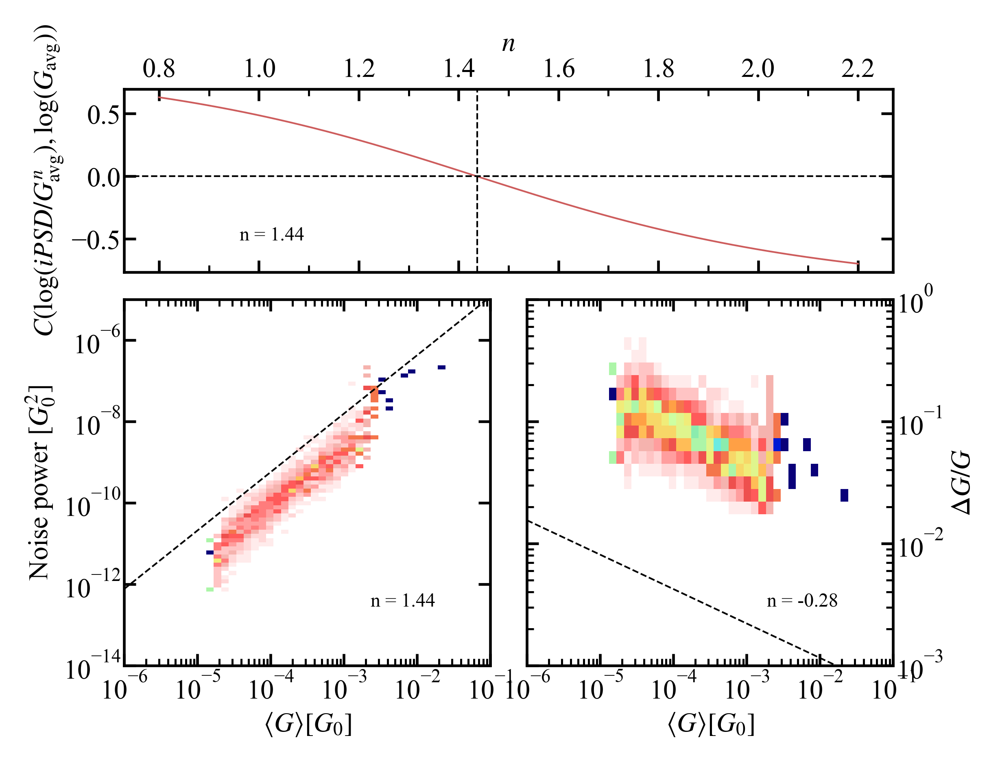

In [69]:
ax_corr, ax_corrhist_1, ax_corrhist_2 = plots.plot_noise_power(N=N, corr=push_corr,
                                                               source=noise_stat_push,
                                                               step=step,
                                                               direction='push', vmax=0.5)

### BJ tunnel linear fit

In [70]:
fit_params = []
fit_errors = []

for trace in tqdm(selected_traces):
    trace_pair = TracePair(trace, load_from=home_folder)
    popt, perr = trace_pair.fit_tunnel()
    
    fit_params.append(popt)
    fit_errors.append(perr)
    
fit_params = np.array(fit_params)
fit_errors = np.array(fit_errors)

  0%|          | 0/415 [00:00<?, ?it/s]

In [71]:
tunnel_slope_1_df = pd.DataFrame({'trace': selected_traces,
                                  'slope': fit_params[:, 0], 
                                  'slope error': fit_errors[:, 0],
                                  'intercept': fit_params[:, 1],
                                  'intercept_error': fit_errors[:, 1]
                                 })

tunnel_slope_1_df.to_csv(home_folder.joinpath('results/IVs/selected/rate_1/fit_tunnel.csv'), index=False)

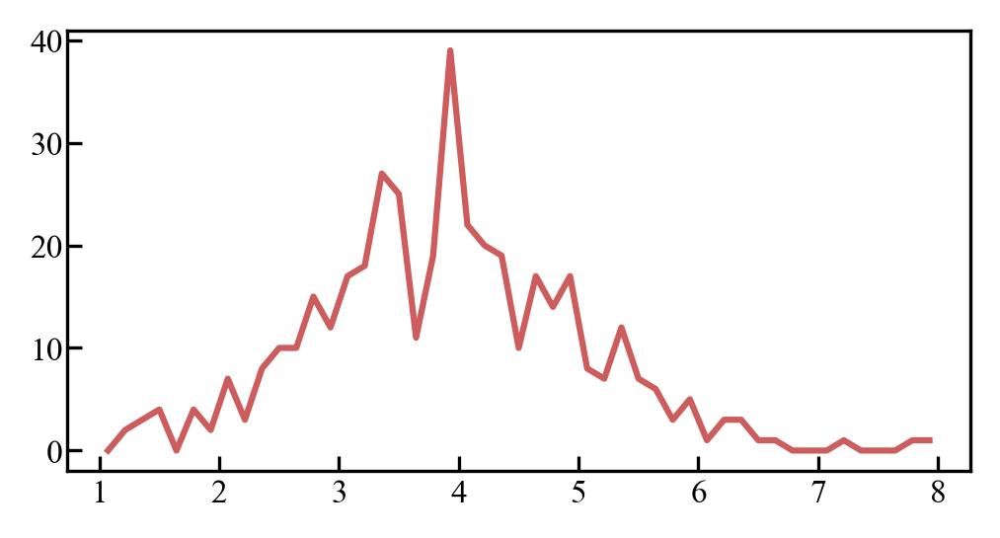

In [72]:
fit_params_bins, fit_params_hist = utils.calc_hist_1d_single(data=fit_params[:, 0], xrange=(1, 8),
                                                             xbins_num=50, log_scale=False)


fig, ax = plt.subplots(1, figsize=utils.cm2inch(10, 5), dpi=300)
ax.plot(fit_params_bins, fit_params_hist, 'indianred')
# ax.axvline(0.5, c='grey', alpha=0.5, ls='--', lw=0.7)

### Save selected I(V) curves in Laci's format

In [73]:
for which_trace in tqdm(selected_traces):
    hold_trace = HoldTrace(which_trace,
                           load_from=home_folder, bias_offset=0,
                           r_serial_ohm=99_900, min_step_len=20_000, min_height=1, iv=1, gain=1e7)
    hold_trace.save_iv_for_laci(home_folder, direction='push')

  0%|          | 0/415 [00:00<?, ?it/s]

***

## After evaporation 36001-56200

In [74]:
hist_4 = Histogram(home_folder, 36_001, 56_200)

hist_4.calc_stats(align_at=1e-5, range_pull=(-0.6, 0.5), range_push=(-2, 1), xbins_pull=250, xbins_push=400,
                  plateau_length_bins=100)

Processing break junction files:   0%|          | 0/203 [00:00<?, ?it/s]

Pull 2D histogram created from 20197 traces
Push 2D histogram created from 20199 traces


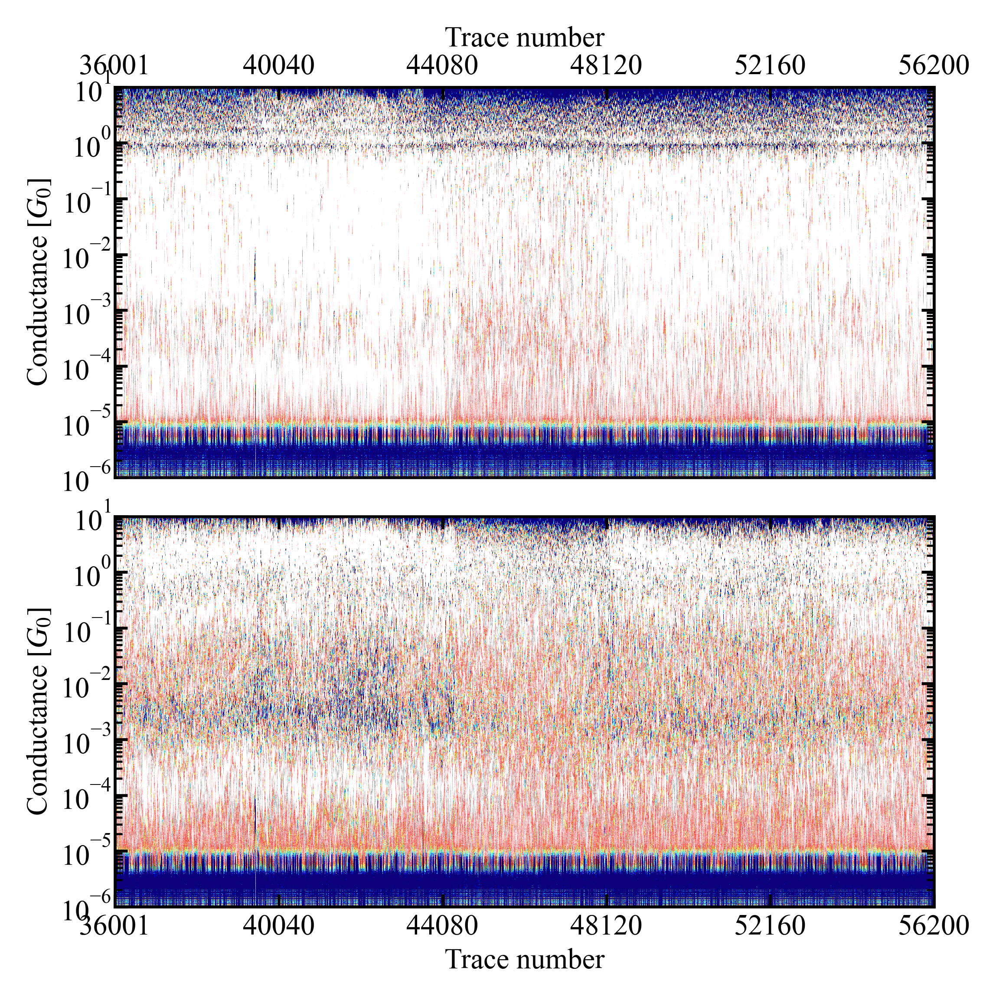

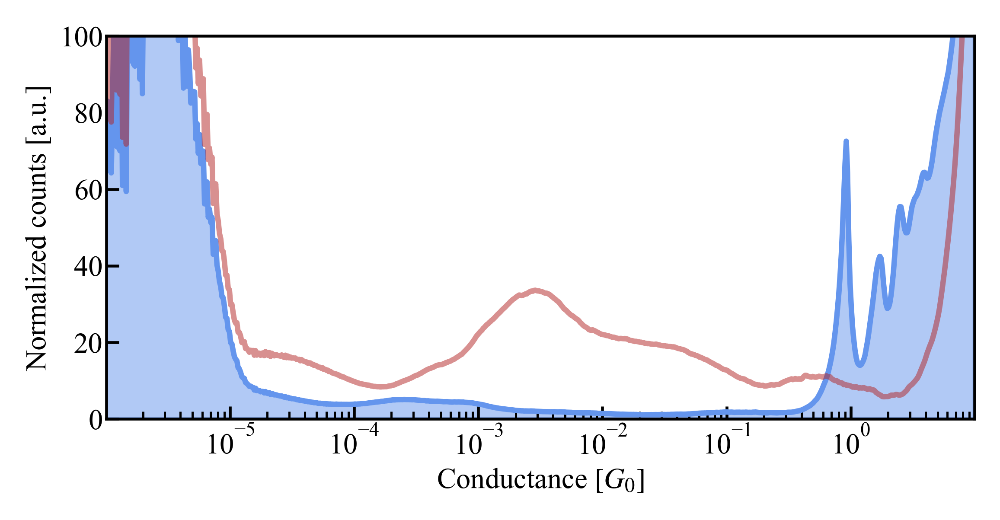

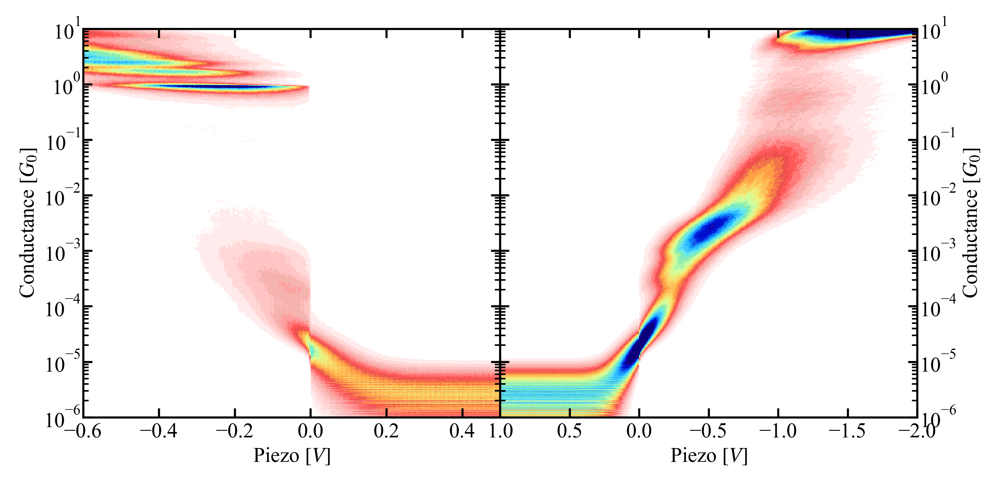

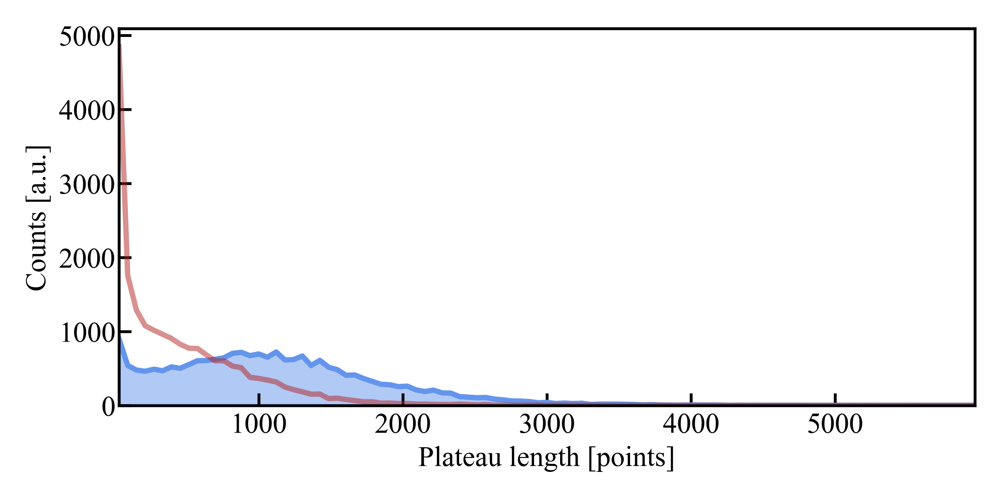

In [75]:
ax_temp_pull, ax_temp_push = hist_4.plot_temporal_hist(vmax=100)
ax_temp_pull.set_xticks(np.linspace(0, 20_200, 6).astype(int))
ax_temp_pull.set_xticklabels(np.linspace(36_001, 56_200, 6).astype(int))
ax_temp_push.set_xticks(np.linspace(0, 20_200, 6).astype(int))
ax_temp_push.set_xticklabels(np.linspace(36_001, 56_200, 6).astype(int))
ax_1d = hist_4.plot_hist_1d(ylims=(0, 100))
ax_pull, ax_push = hist_4.plot_hist_2d_both(vmax=15_000)
ax_plat = hist_4.plot_plateau_length_hist()

In [76]:
hist_4.calc_hist_2d(align_at=0.5, range_pull=(-0.5, 0.6), range_push=(-0.5, 1.5),
                    xbins_pull=200, xbins_push=250)

Calculating 2D conductance-displacement histograms:   0%|          | 0/203 [00:00<?, ?it/s]

2D histogram pull direction created from 20191 traces
2D histogram push direction created from 20200 traces


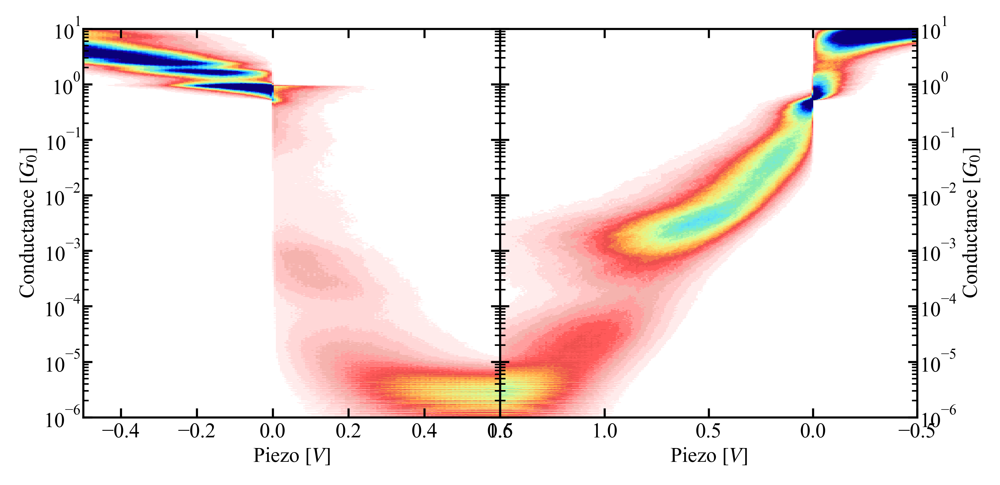

In [77]:
ax_pull, ax_push = hist_4.plot_hist_2d_both(vmax=15_000)

***

## 36001-44200

In [78]:
hist_4 = Histogram(home_folder, 36001, 44000)

hist_4.calc_stats(align_at=1e-5, range_pull=(-0.6, 0.5), range_push=(-2, 1), xbins_pull=250, xbins_push=400,
                  plateau_length_bins=100)

Processing break junction files:   0%|          | 0/81 [00:00<?, ?it/s]

Pull 2D histogram created from 7998 traces
Push 2D histogram created from 7999 traces


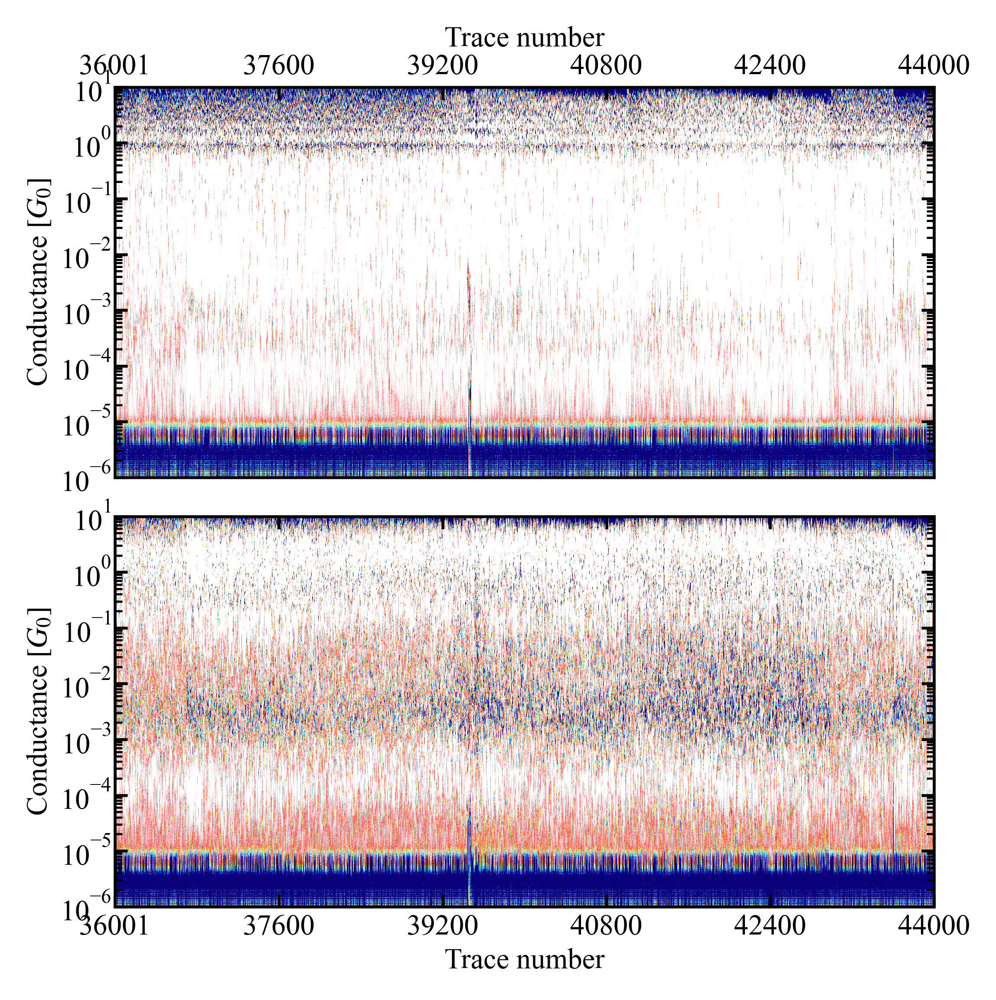

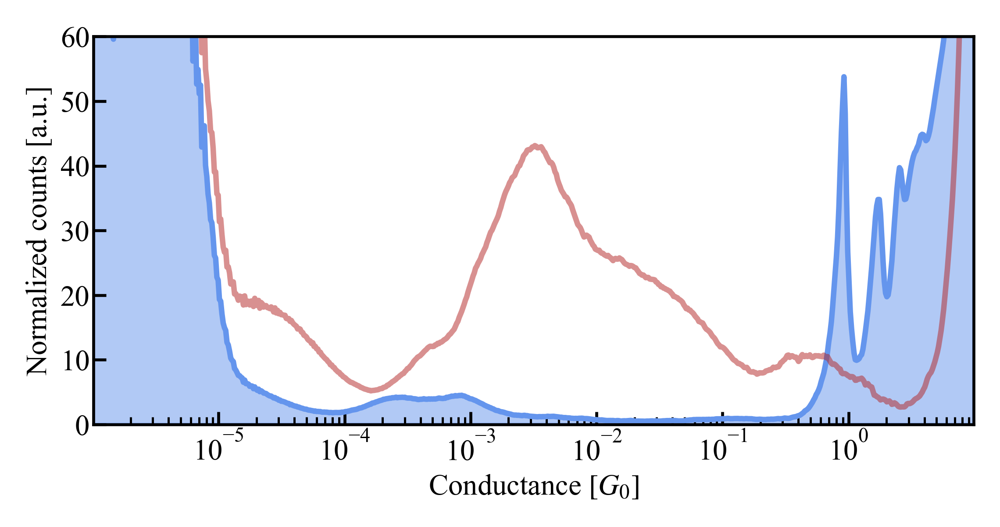

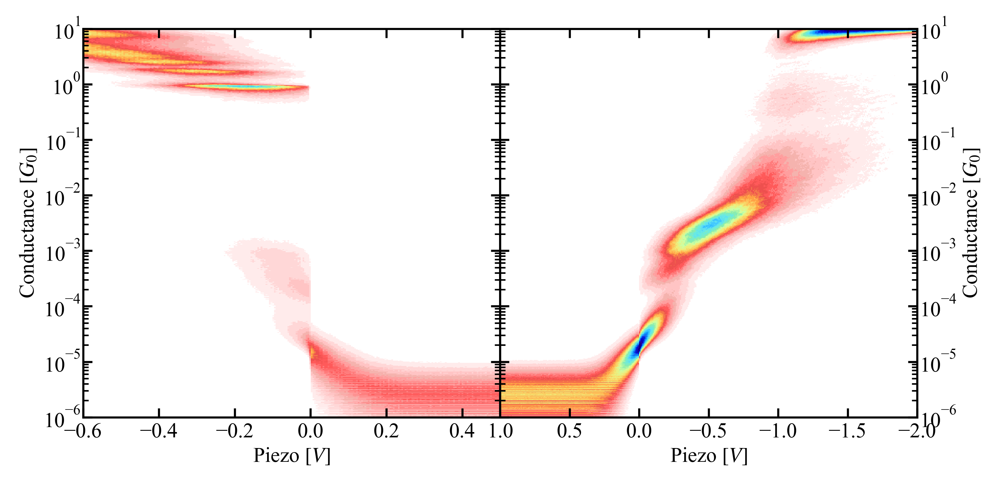

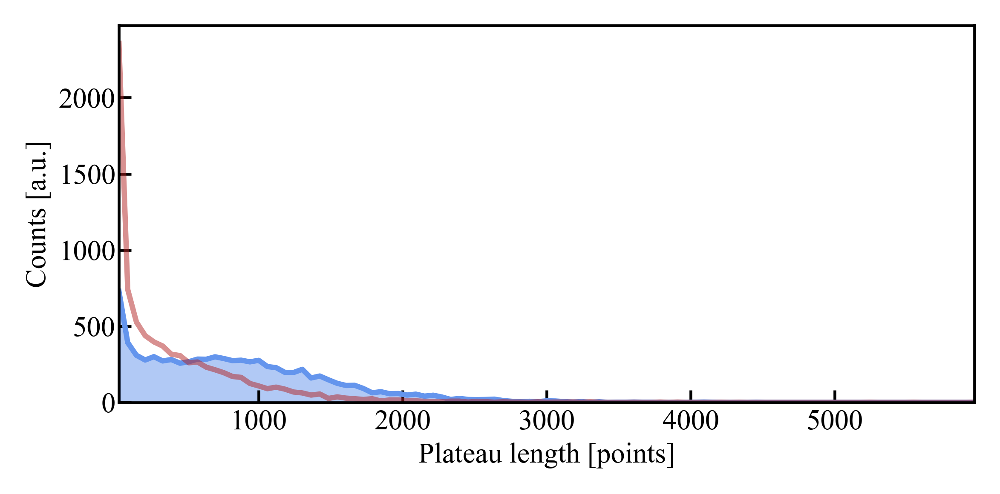

In [79]:
ax_temp_pull, ax_temp_push = hist_4.plot_temporal_hist(vmax=100)
ax_temp_pull.set_xticks(np.linspace(0, 8_000, 6).astype(int))
ax_temp_pull.set_xticklabels(np.linspace(36_001, 44_000, 6).astype(int))
ax_temp_push.set_xticks(np.linspace(0, 8_000, 6).astype(int))
ax_temp_push.set_xticklabels(np.linspace(36_001, 44_000, 6).astype(int))
ax_1d = hist_4.plot_hist_1d(ylims=(0, 60))
ax_pull, ax_push = hist_4.plot_hist_2d_both(vmax=10_000)
ax_plat = hist_4.plot_plateau_length_hist()

In [80]:
hist_4.calc_hist_2d(align_at=0.5, range_pull=(-0.5, 0.6), range_push=(-0.5, 1.5),
                    xbins_pull=200, xbins_push=250)

Calculating 2D conductance-displacement histograms:   0%|          | 0/81 [00:00<?, ?it/s]

2D histogram pull direction created from 7994 traces
2D histogram push direction created from 8000 traces


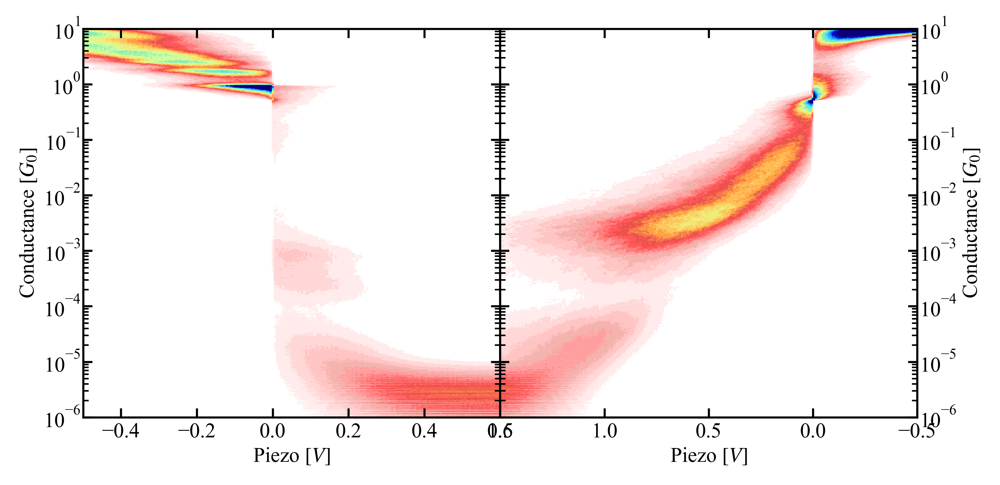

In [81]:
ax_pull, ax_push = hist_4.plot_hist_2d_both(vmax=10_000)